In [0]:
from pyspark.sql.functions import col, when, count, min, date_sub, concat_ws, substring, lit, coalesce, collect_list, countDistinct, expr, datediff, max, row_number
from pyspark.sql.window import Window
import matplotlib.pyplot as plt 
import pandas as pd
from pyspark.sql.functions import sum as _sum

In [0]:
# add drug strings here for defining patient cohorts
cs_syns='17beta oestradiol,ABL,ABPC,ACh,ALA,AP,Abarelix,Abarelix,Abomacetin,Acalabrutinib,Acalabrutinib,Acalabrutinibum,Acamprosate,Acamprosate,Acamprosato,Acamprosatum,Acepromazina,Acepromazine,Acepromazine,Acepromazinum,Acetazine,Acetic acid, zinc salt,Acetophenazina,Acetophenazine,Acetophenazine,Acetophenazinum,Acetopromazine,Acetylcholine,Acetylmethylcholine,Acetylpromazine,Acid maltase,Acide Arsenieux,Acide butanedioïque,Acide carbolique,Acide gadobenique,Acide nicotinique,Acide octadécanoïque,Acide phénique,Acide stéarique,Acide succinique,Acide étacrynique,Acido gadobenico,Acidum Nicotinicum,Acidum citricum,Acidum etacrynicum,Acidum gadobenicum,Acidum succinicum,Acitretin,Acitretin,Acitretina,Acitretine,Acitretinum,Aclidinio,Aclidinium,Acrivastine,Acrivastine,Activated protein C,Adalimumab,Adapalene,Adapalene,Adapaleno,Adapalenum,Adapalène,Adenin riboside,Adenine Deoxyribonucleoside,Adenogesic,Adenosin,Adenosina,Adenosine,Adenosine,Adenosinum,Adipiodona,Adipiodone,Adipiodonum,Ado,Adrenaline,Adrénaline,Adénosine,Afamelanotide,Afamelanotide,Afatinib,Afatinib,Afatinibum,Aglucosidase alfa,Aglucosidase alpha,Agolutin,Agomelatina,Agomelatine,Agomelatine,Akrolutin,Al,Albuterol,Alcaftadina,Alcaftadine,Alcaftadine,Alcaftadinum,Alfentanil,Alfentanil,Alfentanilo,Alfentanilum,Alfentanyl,Alfuzosin,Alfuzosin,Alfuzosina,Alfuzosine,Alfuzosinum,Alglucosidasa alfa,Alglucosidase alfa,Alimemazina,Alimemazine,Alimemazine,Alimemazinum,Almotriptan,Almotriptan,Alotano,Alpha lipoic acid,Alum, potassium,Aluminio,Aluminium,Aluminium,Aluminium atom,Aluminium metallicum,Aluminium phosphate,Aluminium potassium sulfate,Aluminum,Aluminum acetate,Aluminum metal,Aluminum phosphate,Aluminum potassium alum,Aluminum potassium disulfate,Aluminum potassium sulfate,Aluminum potassium sulfate anhydrous,Aluminum powder,Alverina,Alverine,Alverine,Alverinum,Alvimopan,Alvimopan,Alvimopan anhydrous,Amantadina,Amantadine,Amantadine,Amantadinum,Amantidine,Amber acid,Amcinonide,Amcinonide,Amcinonidum,Amcinónida,Amfetamina,Amfetamine,Amfetaminum,Amidopropyldimethylbetaine,Aminoacetic acid,Aminoadamantane,Aminobenzylpenicillin,Aminoessigsäure,Aminoethanoic acid,Aminofilina,Aminophyllin,Aminophylline,Aminophylline,Aminophyllinum,Aminosultopride,Amisulprida,Amisulpride,Amisulpride,Amisulpridum,Amitriptilina,Amitriptylin,Amitriptyline,Amitriptyline,Amitriptylinum,Amoxapin,Amoxapina,Amoxapine,Amoxapine,Amoxapinum,Amoxepine,Amphetamine,Amphetamine,Ampicilina,Ampicillin,Ampicillin,Ampicillin acid,Ampicillin anhydrous,Ampicillin, anhydrous,Ampicilline,Ampicillinum,Amrinona,Amrinone,Amrinone,Amrinonum,Angiotensin,Angiotensin II,Angiotensin II,Angiotonin,Anhydride Arsenieux,Anhydrous alvimopan,Anhydrous ampicillin,Anhydrous caffeine,Anhydrous cefalexin,Anhydrous cephalexin,Anhydrous citric acid,Anhydrous dextrose,Anhydrous morphine,Anileridina,Anileridine,Anileridine,Anileridinum,Anisotropine methobromide,Anisotropine methylbromide,Anisotropine methylbromide,Antazolina,Antazoline,Antazoline,Antazolinum,Antithymocyte immunoglobulin,Apomorfina,Apomorphin,Apomorphine,Apomorphine,Apraclonidina,Apraclonidine,Apraclonidine,Apraclonidinum,Arbutamina,Arbutamine,Arbutamine,Arbutaminum,Arbutin,Argatroban,Argatroban,Argatroban anhydrous,Argentum metallicum,Aripiprazol,Aripiprazole,Aripiprazole,Aripiprazole lauroxil,Aripiprazole lauroxil,Aripiprazolum,Arsenic Blanc,Arsenic oxide,Arsenic trioxide,Arsenic trioxide,Arsenigen Saure,Arsenolite,Arsenous oxide,Arsenous oxide anhydride,Arterenol,Asenapine,Asenapine,Asuccin,Atenolol,Atenolol,Atenololum,Atomoxetina,Atomoxetine,Atomoxetine,Atosiban,Atosiban,Atropin,Atropina,Atropine,Atropine,Atropinum,Auranofin,Auranofin,Auranofina,Auranofine,Auranofinum,Azatadin,Azatadina,Azatadine,Azatadine,Azatadinum,Azilsartan,Azilsartan kamedoxomil,Azilsartan medoxomil,Azilsartan medoxomil,Azilsartan médoxomil,Azilsartanum medoxomilum,Azilsartán medoxomilo,BAL,BPN,Basic bismuth salicylate,Benzaphetamine,Benzatropina,Benzatropine,Benzatropine,Benzatropinum,Benzazoline,Benzenol,Benzfetamina,Benzfetamine,Benzfetaminum,Benzoylmethylecgonine,Benzphetamine,Benzphetamine,Benztropine,Benzylamphetamine,Bepotastine,Bepotastine,Bernsteinsäure,Betahistina,Betahistine,Betahistine,Betahistinum,Bethanechol,Bethanechol,Bilastina,Bilastine,Bilastine,Biochrome,Biperiden,Biperiden,Biperidene,Biperideno,Biperidenum,Bismuth Subsalicylate,Bismuth oxide salicylate,Bismuth oxysalicylate,Bismuth subgallate,Bismuth subgallate,Bismuth subsalicylate,Bismuto subgalato,Bisoprolol,Bisoprolol,Bisoprololum,Blinatumomab,Botulin B,Botulinum B toxin,Botulinum Toxin Type B,Botulinum neurotoxin type B precursor,Brexpiprazole,Brexpiprazole,Brigatinib,Brigatinib,British antilewisite,Bromazina,Bromazine,Bromazinum,Bromfeniramina,Bromochlorotrifluoroethane,Bromocriptina,Bromocriptine,Bromocriptine,Bromocriptinum,Bromocryptine,Bromodiphenhydramine,Bromoergocriptine,Bromoergocryptine,Brompheniramin,Brompheniramine,Brompheniramine,Brompheniraminum,Bromphéniramine,Bromure de Clidinium,Bromuro de clidinio,Buclizina,Buclizine,Buclizine,Buclizinum,Budesonide,Budesonide,Budesónida,Bumetanida,Bumetanide,Bumetanide,Bumetanidum,Buprenophine,Buprenorfina,Buprenorphine,Buprenorphine,Buprenorphinum,Burnt potassium alum,Buserelin,Buserelina,Buspiron,Buspirona,Buspirone,Buspirone,Buspironum,Butamben,Butamben,Butandisäure,Butanedioic acid,Butanedionic acid,Butorfanol,Butorphanol,Butorphanol,Butorphanolum,Butriptyline,Butyl aminobenzoate,Butylscopolamine,Bétahistine,C1 inhibitor,C1 inhibitor human,C12 fatty acid,C12:0,C18:0,CBD,CDDP,CET,CNC,CP,CPZ,Cabergolina,Cabergoline,Cabergoline,Cabergolinum,Cafeína,Caffeine,Caffeinum,Caféine,Calcium Citrate,Calcium Phosphate,Calcium monohydrogen phosphate dihydrate,Calcium phosphate dibasic, hydrous,Calcium phosphate dihydrate,Calcium phosphate dihydrate, dibasic,Calcium phosphate, dibasic, dihydrate,Calcium phosphate, dibasic, hydrous,Calcium phosphates,Candesartan cilexetil,Candesartan cilexetil,Cangrelor,Cangrelor,Cannabidiol,Cannabidiol,Capazine,Captopril,Captopril,Captoprilum,Captopryl,Carbacholine,Carbamoylcholine,Carbamylcholine,Carbetapentane,Carbinoxamin,Carbinoxamina,Carbinoxamine,Carbinoxamine,Carbinoxamine base,Carbinoxaminum,Carbolic acid,Carbolsäure,Carbonyl iron,Carboxyterfenadine,Carfentanil,Carfentanil,Carfentanyl,Cariprazine,Cariprazine,Carvedilol,Carvedilol,Carvedilolum,Carvédilol,Caryophylii floris aetheroleum,Caryophyllus aromaticus bud oil,Cefalexin,Cefalexin anhydrous,Cefalexina,Cefalexinum,Cefalothin,Cefalotin,Cefalotin,Cefalotina,Cefalotinum,Cefiderocol,Cefiderocol,Cefmetazole,Cefmetazole,Cefmetazolo,Cefmetazolum,Cefonicid,Cefonicid,Cefonicido,Cefonicidum,Cefoperazone,Cefoperazone,Cefoperazono,Cefoperazonum,Cefotaxim,Cefotaxima,Cefotaxime,Cefotaxime,Cefotaximum,Cefotetan,Cefotetan,Cefotetanum,Cefpiramide,Cefpiramide,Cefpiramido,Cefpiramidum,Ceftriaxona,Ceftriaxone,Ceftriaxone,Ceftriaxonum,Cephalexin,Cephalexin anhydrous,Cephalothin,Cephalotin,Cephotaxime,Cerliponase alfa,Certolizumab pegol,Certolizumab pegol,Cetirizin,Cetirizina,Cetirizine,Cetirizine,Cetirizinum,Cetrorelix,Cetrorelix,Cetrorelixum,Cetuximab,Cetuximab,Cetuximabum,Cevimelina,Cevimeline,Cevimeline,Cevimelinum,Chitosamine,Chlophedianol,Chlorcyclizin,Chlorcyclizine,Chlorcyclizine,Chlorcyclizinum,Chlormeprazine,Chloropernazine,Chlorophenylpyridamine,Chlorphenamin,Chlorphenamine,Chlorphenaminum,Chlorpheniramine,Chlorpheniramine,Chlorpheniramine polistirex,Chlorpheniraminum,Chlorphthalidolone,Chlorpiprazine,Chlorpromazine,Chlorpromazine,Chlorpromazinum,Chlorprothixen,Chlorprothixene,Chlorprothixene,Chlorprothixine,Chlorprotixen,Chlorprotixene,Chlorprotixine,Chlortalidone,Chlortalidonum,Chlortetracycline,Chlortetracycline,Chlortetracyclinum,Chlorthalidone,Chlorthalidone,Chlortétracycline,Chlothixen,Cholecystokinin,Choline acetate,Choline carbamate,Choline theophyllinate,Choline theophylline,Cholini theophyllinas,Chrom,Chromic nitrate,Chromium,Chromium gluconate,Chromium nicotinate,Chromium, elemental,Chromous sulfate,Chrysazin,Cianocobalamina,Ciclizina,Ciclobenzaprina,Ciclopentolato,Cicrimina,Cinacalcet,Cinacalcet,Cinarizina,Cinnarizine,Cinnarizine,Cinnarizinum,Ciproheptadina,Cisplatin,Cisplatin,Citric Acid, Anhydrous,Citric acid,Citric acid monoglyceride,Citric acid,anhydrous,Citronensäure,Clemastina,Clemastine,Clemastine,Clemastinum,Clenbuterol,Clenbuterol,Clenbuterolum,Clenbutérol,Clidinii Bromidum,Clidinium,Clidinium bromid,Clofedanol,Clofedanol,Clofedanolum,Clofedianolo,Clopidogrel,Clopidogrel,Clopidogrelum,Clorciclicina,Clorciclizina,Clorciclizinio,Clorfenamina,Clorfeniramina,Clorpromazina,Clortalidona,Clortetraciclina,Clotrimazol,Clotrimazole,Clotrimazole,Clotrimazolum,Clove bud oil,Clove oil,Clove volatile oil,Cloxacilina,Cloxacillin,Cloxacillin,Cloxacilline,Cloxacillinum,Clozapin,Clozapina,Clozapine,Clozapine,Clozapinum,Cocain,Cocaina,Cocaine,Cocainum,Coconut oil fatty acids,Codein,Codeine,Codeine anhydrous,Codeine polistirex,Codeinum,Codeína,Codéine,Coenzyme Q10,Coffein,Coffeinum,Colloidal silver,Complement C1 esterase inhibitor,Conestat alfa,Conivaptan,Conivaptan,Copanlisib,Copanlisib,Copper,Copper monosulfate,Copper monosulphate,Copper sulfate,Copper sulphate,Corpus Luteum Hormone,Cortisol,Crofelemer,Crofelemer,Cromo,Cryptenamine,Cupric oxide,Cupric sulfate,Cupric sulfate anhydrous,Cupric sulfate, anhydrous,Cupric sulphate anhydrous,Cupric sulphate, anhydrous,Cuprous Oxide,Cuprum oxydatum nigrum,Cyanocobalamin,Cyanocobalamin,Cyanocobalamine,Cyanocobalaminum,Cyclizine,Cyclizine,Cyclizinum,Cyclobenzaprine,Cyclobenzaprine,Cyclobenzaprinum,Cyclopentolate,Cyclopentolate,Cyclopentolatum,Cycrimine,Cycrimine,Cycriminum,Cyproheptadin,Cyproheptadine,Cyproheptadine,Cyproheptadinum,Cysteamine,Cysteamine,Céfalexine,Céfalotine,Céfotaxime,Cétuximab,Cévimèline,D.C.P.,DAO,DDVP,DFO,DFOA,DFOM,DFP,DM,DMI,DOPS,Dacomitinib,Dacomitinib,Dacomitinib anhydrous,Dacomitinibum,Danazol,Danazol,Danazolum,Danthron,Dantron,Dantron,Dantrona,Dantrone,Dantronum,Dapiprazol,Dapiprazole,Dapiprazole,Dapiprazolum,Darifenacin,Darifenacin,Darifenacina,Darifenacinum,Darifénacine,Daturin,Daturine,Deferoxamin,Deferoxamina,Deferoxamine,Deferoxamine,Deferoxaminum,Deferrioxamine,Deferrioxamine B,Defibrotide,Defibrotide free acid,Degarelix,Degarelix,Demethylamitriptyline,Desamfetamina,Desbrofeniramina,Descarboethoxyloratadine,Desferrioxamine,Desflurane,Desflurane,Desflurano,Desfluranum,Desipramin,Desipramina,Desipramine,Desipramine,Desipraminum,Desloratadina,Desloratadine,Desloratadine,Desmethylamitriptyline,Desmethylimipramine,Desmethylloxapin,Desmopresina,Desmopressin,Desmopressin,Desmopressine,Desmopressinum,Desoxynorephedrine,Destropropossifene,Detemir,Dex,Dexametasona,Dexamethasone,Dexamethasone,Dexamethasonum,Dexamfetamina,Dexamfetamine,Dexamfetaminum,Dexamphetamine,Dexaméthasone,Dexanfetamina,Dexbromfeniramina,Dexbrompheniramin,Dexbrompheniramine,Dexbrompheniramine,Dexbrompheniraminum,Dexbromphéniramine,Dexchlorpheniramine maleate,Dexfenfluramina,Dexfenfluramine,Dexfenfluramine,Dexfenfluraminum,Dexibuprofen,Dexibuprofeno,Dextran iron,Dextroamphetamine,Dextroamphetamine,Dextrofenfluramine,Dextromethorfan,Dextromethorphan,Dextromethorphan,Dextromethorphanum,Dextrometorfano,Dextrométhorphane,Dextropropoxifeno,Dextropropoxyphen,Dextropropoxyphene,Dextropropoxyphene,Dextropropoxyphenum,Dextropropoxyphène,Dextroproxifeno,Dextrosa,Dextrose,Dextrose anhydrous,Dextrose solution,Dextrose, anhydrous,Dextrose, unspecified,Dextrose, unspecified form,Dezocina,Dezocine,Dezocine,Dezocinum,Diacetylmorphine,Diamorphine,Diamorphine,Diarsenic oxide,Diarsenic trioxide,Dibasic calcium phosphate dihydrate,Dibasic calcium phosphate hydrate,Dicalcium phosphate dihydrate,Dicarbomethoxyzinc,Dichlorvos,Dichlorvos,Dicholine succinate,Dicicloverina,Dicyclomine,Dicyclomine,Dicycloverin,Dicycloverine,Dicycloverinum,Didanosina,Didanosine,Didanosine,Didanosinum,Dideoxyinosine,Difenhidramina,Difenidol,Difenidolo,Difenidolum,Difenilpiralina,Difenossilato,Difenoxilato,Difénidol,Dihidroergotamina,Dihydrocodeinone,Dihydroergotamin,Dihydroergotamine,Dihydroergotamine,Dihydroergotaminum,Dihydrofumaric acid,Dihydrohydroxycodeinone,Dihydrohydroxymorphinone,Dihydromorfinon,Dihydromorphinone,Dihydroxycodeinone,Dihydroxymorphinone,Dihydroxypropyl theopylin,Diidroergotamina,Diisopropoxyphosphoryl fluoride,Diisopropyl fluorophosphate,Diisopropyl fluorophosphonate,Diisopropyl phosphofluoridate,Diisopropyl phosphorofluoridate,Diisopropylfluorophosphate,Diisopropylfluorophosphoric acid ester,Diisopropylphosphofluoridate,Diisopropylphosphorofluoridate,Dimenhidrinato,Dimenhydrinate,Dimenhydrinate,Dimenhydrinatum,Dimercaprol,Dimercaprol,Dimercaprolum,Dimercaptopropanol,Dimethindene,Dimethylchondrocurarine,Dimetindene,Dimetindeno,Dimorphone,Dinakrome,Ding xiang bud oil,Diphemanil,Diphemanil cation,Diphemanil ion,Diphenhydramine,Diphenhydramine,Diphenhydramine theoclate,Diphenhydraminum,Diphenidol,Diphenidol,Diphenoxylate,Diphenoxylate,Diphenoxylatum,Diphenylpyralamine,Diphenylpyraline,Diphenylpyraline,Diphenylpyralinum,Dipivalyl epinephrine,Dipivefrin,Dipivefrin,Dipivefrina,Dipivefrine,Dipivefrinum,Dipivéfrine,Diprenorfin,Diprenorphine,Diprofilina,Diprophylline,Diprophyllinum,Disopiramida,Disopyramide,Disopyramide,Disopyramidum,Dithioglycerine,Dithioglycerol,Dobutamin,Dobutamina,Dobutamine,Dobutamine,Dobutaminum,Dodecanoic acid,Dodecoic acid,Dodecylcarboxylate,Dodecylic acid,Domperidona,Domperidone,Domperidone,Domperidonum,Dopamina,Dopamine,Dopamine,Dopaminum,Dossilamina,Dosulepin,Dosulepina,Dosulepinum,Dosulépine,Dothiepin,Doxacurium,Doxepin,Doxepin,Doxepina,Doxepinum,Doxilamina,Doxilminio,Doxylamine,Doxylamine,Doxylaminum,Dronabinol,Dronabinol,Dronabinolum,Dronedarona,Dronedarone,Dronedarone,Droperidol,Droperidol,Droperidolo,Droperidolum,Dropéridol,Drotrecogin alfa,Drotrecogin alfa activated,Drotrecogin alfa, activated,Droxidopa,Droxidopa,Duboisine,Duodecyclic acid,Duodecylic acid,Dyphylline,Dyphylline,Déferoxamine,Déméthylimipramine,Désipramine,E3A,EPA,Echothiophate,Echothiophate,Ecothiopate,Ecothiopatum,Eculizumab,Eculizumab,Edoxudine,Efedrina,Eicosapentaenoic acid,Eisen,Electrolytic iron,Eletriptan,Eletriptan,Eletriptanum,Eletriptán,Eluxadoline,Eluxadoline,Emedastina,Emedastine,Emedastine,Emedastinum,Enalaprilat,Enalaprilat,Enalaprilat anhydrous,Enprofilina,Enprofylline,Enprofylline,Enprofyllinum,Eparina,Ephedrine,Epinastin,Epinastina,Epinastine,Epinastine,Epinastinum,Epinefrin,Epinefrina,Epinephrin,Epinephrine,Epinephrine,Epinephrinum,Epoprostenol,Epoprostenol,Eprosartan,Eprosartan,Eprosartanum,Ergobasine,Ergometrina,Ergometrine,Ergometrine,Ergometrinum,Ergométrine,Ergonovine,Ergotamin,Ergotamina,Ergotamine,Ergotamine,Ergotaminum,Ergotocine,Ergotyl,Eritromicina,Erlotinib,Erlotinib,Erythromycin,Erythromycin,Erythromycin A,Erythromycin C,Erythromycinum,Escitalopram,Escitalopram,Escitalopramum,Estavudina,Estradiol,Estradiol,Estradiol acetate,Estradiol acetate,Estradiol benzoate,Estradiol benzoate,Estradiol cypionate,Estradiol dienantate,Estradiol dienanthate,Estradiol valerate,Estradiol valerate,Estradiolum,Etacrinic acid,Etacrynic acid,Etacrynic acid,Etafedrine,Etafedrine,Etaperazin,Etaperazine,Etelcalcetida,Etelcalcetide,Etelcalcetide,Etelcalcetidum,Ethacrynate,Ethacrynic acid,Ethaperazine,Ethopropazine,Ethylenesuccinic acid,Ethylnorgestrienone,Etilamide,Etorphine,Etorphine,Etorphinum,Etretin,Eugenia aromatica bud oil,Eugenia caryophyllata bud oil,Exenatida,Exenatide,Exenatide,Exenatide synthetic,Exendin 4,FESO,Fe,Fenfluramina,Fenfluramine,Fenfluramine,Fenfluraminum,Fenilefrina,Fenilpropanolamina,Fenindamina,Feniramina,Fenol,Fenoldopam,Fenoldopam,Fenoldopamum,Fenoprofen,Fenoprofen,Fenoprofeno,Fenoprofenum,Fenossibenzamina,Fenoterol,Fenoterol,Fenoterolum,Fenoxibenzamina,Fentanil,Fentanila,Fentanilo,Fentanyl,Fentanyl,Fentanyl CII,Fentanylum,Fentolamina,Ferric Gluconate,Ferric cation,Ferric citrate,Ferric citrate hydrate,Ferric hydroxide sucrose complex,Ferric ion,Ferrous ascorbate,Ferrous cevitamate,Ferrous fumarate,Ferrous gluconate,Ferrous gluconate anhydrous,Ferrous glycine sulfate,Ferrous glycine sulphate,Ferrous succinate,Ferrous sulfate anhydrous,Ferrum,Ferrum metallicum,Ferumoxytol,Fesoterodina,Fesoterodine,Fesoterodine,Fexofenadina,Fexofenadine,Fexofenadine,Flavoxate,Flavoxate,Flavoxato,Flavoxatum,Flibanserin,Flibanserin,Florbetapir F18,Fludeoxyglucose F 18,Fludrocortison,Fludrocortisona,Fludrocortisone,Fludrocortisone,Fludrocortisonum,Flufenazina,Fluocinolone acetonide,Fluocinolone acetonide,Fluohydrocortisone,Fluopromazine,Fluorfenazine,Fluorodiisopropyl phosphate,Fluorophenazine,Fluorostigmine,Fluorphenazine,Flupenthixol,Flupenthixole,Flupentixol,Flupentixol,Flupentixolo,Flupentixolum,Fluphenazin,Fluphenazine,Fluphenazine,Fluphenazinum,Fluphénazine,Fluspirilene,Fluspirilene,Fluspirileno,Fluspirilenum,Flutemetamol F 18,Flutemetamol F18,Fospropofol,Fospropofol,Fostamatinib,Fostamatinib,Fradiomycin,Fradiomycin B,Framicetina,Framycetin,Framycetin,Framycetinum,Framycétine,Frovatriptan,Frovatriptan,Fénoldopam,Fénoprofène,Ga 68 DOTATOC,Gabapentin,Gabapentin,Gabapentin enacarbil,Gabapentin enacarbil,Gabapentina,Gabapentina enacarbilo,Gabapentine,Gabapentine enacarbil,Gabapentino,Gabapentinum,Gabapentinum enacarbilum,Gadobenate,Gadobenic acid,Gadobenic acid,Gadobensäure,Gadofosveset,Gadofosveset trisodium,Gallamin triethiodid,Gallamine triethiodide,Gallamine triethiodide,Gallamini Triethiodidum,Gallium 68 dotatate,Gallium nitrate,Ganirelix,Ganirelix,Gatate,Gatifloxacin,Gatifloxacin,Gatifloxacin anhydrous,Gatifloxacine,Gatifloxacino,Gatifloxacinum,Gefitinib,Gefitinib,Gelbkörperhormon,Gentamicin,Gentamicin,Gentamicina,Gestrinona,Gestrinone,Gestrinone,Gestrinonum,Glicina,Glicopirronio,Glizigen,Glu,Glucagon,Glucagon,Glucagon recombinant,Glucagon, human,Glucagon, porcine,Glucagone,Glucagonum,Glucosa,Glucosamina,Glucosamine,Glucosamine,Glucose,Glucose anhydrous,Glucose, anhydrous,Glucose, liquid,Glutamic acid,Glutamic acid,Gly,Glycin,Glycine,Glycine,Glycocoll,Glycopyrrolate cation,Glycopyrrolate ion,Glycopyrronium,Glycopyrronium,Glycopyrronium cation,Glycopyrronium ion,Glycyrrhizic acid,Glycyrrhizin,Glykokoll,Glyzin,GnRH,Golimumab,Golimumab,Gonadorelin,Gonadorelin,Gonadorelina,Gonadorelinum,Gonadoréline,Goserelin,Goserelin,Goserelina,Grape sugar,Guaiacol,Guaranine,Haloperidol,Haloperidol,Haloperidolum,Halotano,Halothane,Halothane,Halothanum,Heparin,Heparina,Heparine,Heparinic acid,Heparinum,Heroin,Hexocyclium,Hidrocodona,Hidrocortisona,Hidromorfona,Hidroxizina,Hierro,Histamine,Histrelin,Histrelin,Homatropina,Homatropine,Homatropine methylbromide,Homatropine methylbromide,Homatropini methylbromidum,Human C1 inhibitor,Human IGG,Human angiotensin II,Human immunoglobulin G,Human immunoglobulin G,Human normal immunoglobulin,Human somatomedin C,Hyaluronidase human recombinant,Hyaluronidase recombinant human,Hyaluronidase, human,Hyaluronidase, ovine,Hychotine,Hydrocodon,Hydrocodone,Hydrocodone,Hydrocodonum,Hydrocone,Hydroconum,Hydrocortisone,Hydrocortisone,Hydrocortisone aceponate,Hydrocortisone acetate,Hydrocortisone buteprate,Hydrocortisone butyrate,Hydrocortisone butyrate,Hydrocortisone butyrate propionate,Hydrocortisone cipionate,Hydrocortisone cypionate,Hydrocortisone phosphate,Hydrocortisone probutate,Hydrocortisone probutate,Hydrocortisone valerate,Hydrocortisone valerate,Hydrocortisonum,Hydroksyzyny,Hydromorfona,Hydromorphone,Hydromorphone,Hydromorphonum,Hydroquinone,Hydroxine,Hydroxizine,Hydroxizinum,Hydroxybenzene,Hydroxycine,Hydroxynorephedrine,Hydroxyzin,Hydroxyzine,Hydroxyzine,Hydroxyzinum,Hyoscine,Hyoscine methobromide,Hyoscine methyl bromide,Hyoscyamin,Hyoscyamine,Hyoscyamine,Hyoscyaminum,Hypertensin,IVIg,Ibalizumab,Icatibant,Icatibant,Icosapent,Icosapent,Icosapentaenoic acid,Icosapento,Icosapentum,Idrocodone,Idromorfone,Idrossizina,Iloperidona,Iloperidone,Iloperidone,Iloperidonum,Ilopéridone,Imipramin,Imipramina,Imipramine,Imipramine,Imipraminum,Imizine,Immune globulin human,Immunoglobulin G, human,Inamrinone,Infliximab,Inositol hexanicotinate,Inositol niacinate,Inositol nicotinate,Inositol nicotinate,Insulin degludec,Insulin detemir,Insulin detemir recombinant,Insulin porcine,Insulin pork,Insulin purified porcine,Insulin purified pork,Insulin, porcine,Insulin, regular, pork,Insulin,detemir,human,Insulina degludec,Insulina detemir,Iodipamide,Iopodic acid,Ipodate,Ipratropium,Ipratropium cation,Ipratropium ion,Irbesartan,Irbesartan,Iron,Iron Dextran,Iron dextran complex,Iron oxide saccharated,Iron powder,Iron saccharate,Iron succinate,Iron sucrose,Iron sucrose,Iron sucrose complex,Iron sugar,Iron, carbonyl,Iron, electrolytic,Iron, elemental,Iron, reduced,Isoephedrine,Isoetarina,Isoetarinum,Isoetharine,Isoetharine,Isofluorphate,Isoflurophate,Isoflurophate,Isoflurophosphate,Isometepteno,Isometheptene,Isometheptene,Isometheptenum,Isonipecaïne,Isoprenalina,Isoprenaline,Isoprenaline,Isoprenalinum,Isopropamide,Isopropamide,Isopropyl fluophosphate,Isopropyl noradrenaline,Isopropyl phosphorofluoridate,Isoproterenol,Isoprénaline,Istradefylline,Istradefylline,Ivacaftor,Ivacaftor,Ivacaftorum,Johimbin,Kaomycine,Karbolsäure,Ketamina,Ketamine,Ketamine,Ketaminum,Ketoprofen,Ketoprofen,Ketoprofeno,Ketotifen,Ketotifen,Ketotifene,Ketotifeno,Ketotifenum,Koffein,Kokain,Kupfer,Kétamine,LAAM,Labetalol,Labetalol,Labetalolum,Labetolol,Labétalol,Lamotrigina,Lamotrigine,Lamotrigine,Lamotriginum,Lanreotida,Lanreotide,Lanreotide,Lapatinib,Lapatinib,Lasmiditan,Lasmiditan,Lasofoxifene,Lauric acid,Laurinsäure,Laurostearic acid,Laurylsiran sodny,Leimzucker,Leuprolide,Leuprorelin,Leuprorelina,Leuproreline,Leuprorelinum,Levacetilmetadol,Levacetylmethadol,Levacetylmethadol,Levacetylmethadolum,Levallofano,Levallorphan,Levallorphan,Levallorphanum,Levalorfano,Levocabastina,Levocabastine,Levocabastine,Levocabastinum,Levocetirizina,Levocetirizine,Levocetirizine,Levodopa,Levodopa,Levodopum,Levoepinephrine,Levomenthol,Levomenthol,Levomentholum,Levomentol,Levomepromazina,Levomepromazine,Levomepromazinum,Levomethadyl,Levomethadyl acetate,Levorfanol,Levorfanolo,Levorphanol,Levorphanol,Levorphanolum,Linolenic acid,Lipoic acid,Lipoic acid,Liquid glucose,Liraglutida,Liraglutide,Liraglutide recombinant,Liraglutidum,Lisurid,Lisurida,Lisuride,Lisuride,Lisuridum,Lofexidina,Lofexidine,Lofexidine,Lofexidinum,Loperamid,Loperamida,Loperamide,Loperamide,Loperamidum,Lopéramide,Lorpiprazole,Loxapina,Loxapine,Loxapine,Loxapinum,Lumateperone,Lumateperone,Lurasidona,Lurasidone,Lurasidone,Lurasidonum,Lutein,Luteohormone,Lutetium Lu 177 dotatate,Lutogynon,Lypressin,Lysine vasopressin,Lévallorphane,Lévomenthol,Lévomépromazine,Lévorphanol,MCh,MEA,MNTX,MPH,Macimorelin,Macimorelin,Magnesio,Magnesium,Magnesium metallicum,Magnesium powder,Magnésium,Mangafodipir,Manganese,Maprotilina,Maprotiline,Maprotiline,Maprotilinum,Maprotylina,Maraviroc,Maraviroc,Maravirocum,Margonovine,Mateína,Mecasermin,Mecasermin recombinant,Mecasermin rinfabate,Mecasermin rinfabate,Mecasermin rinfabate recombinant,Mecasermina,Mechano growth factor,Meclizine,Meclizine,Meclozina,Meclozine,Melanotan 1,Melanotan I,Memantina,Memantine,Memantine,Memantinum,Mentol,Mepenzolate,Mepenzolate,Mepenzolic acid,Meperidina,Meperidine,Mepiramina,Mepirzapine,Mepyramine,Mepyramine,Mercaptamina,Mercaptamine,Mercaptaminum,Mereletinib,Mesoridazina,Mesoridazine,Mesoridazine,Mesoridazinum,Metaciclina,Metacycline,Metacycline,Metadona,Metallic aluminum,Metaproterenol,Metaraminol,Metaraminol,Metaraminolum,Methacholine,Methacholine,Methacholinum,Methacycline,Methacyclinum,Methadone,Methadone,Methadonum,Methantheline,Methantheline,Methantheline cation,Methantheline ion,Methanthelinium,Methanthelinum,Methdilazine,Methdilazinum,Methixen,Methixene,Methotrimeprazine,Methotrimeprazine,Methoxamin,Methoxamine,Methoxaminum,Methscopolamine bromide,Methscopolamine bromide,Methyl benzoylecgonine,Methyl phenidylacetate,Methylenebutyrylphenoxyacetic acid,Methylenecycline,Methylergobasin,Methylergometrin,Methylergometrine,Methylergometrine,Methylergometrinum,Methylergonovine,Methylhomatropine,Methylhomatropine bromide,Methylhomatropinum bromatum,Methylmorphine,Methylnaltrexone,Methyloctatropine bromide,Methylphenidan,Methylphenidate,Methylphenidate,Methylphenidatum,Methylprednisolon,Methylprednisolone,Methylprednisolone,Methylprednisolonum,Methylpromazine,Methylscopolamine bromide,Methyltheobromine,Methysergide,Methysergide,Methysergidum,Metilbromuro de homatropina,Metilbromuro de octatropina,Metilergometrina,Metilergometrinio,Metilfenidato,Metilprednisolona,Metisene,Metisergida,Metisergido,Metixene,Metixene,Metixeno,Metixenum,Metoclopramida,Metoclopramide,Metoclopramide,Metoclopramidum,Metocurine,Metodilazina,Metoprolol,Metoprolol,Metossamina,Metoxamina,Mg,Mianserin,Mianserin,Mianserina,Mianserine,Mianserinum,Mianseryna,Miansérine,Midodrin,Midodrina,Midodrine,Midodrine,Midodrinum,Minaprina,Minaprine,Minaprinum,Mirtazapin,Mirtazapina,Mirtazapine,Mirtazapine,Mirtazapinum,Mivacurium,Mivacurium,Mogamulizumab,Molindona,Molindone,Molindone,Molindonum,Monodemethylimipramine,Monohydroxybenzene,Morfina,Morphia,Morphin,Morphine,Morphine,Morphine monomethyl ether,Morphinum,Morphium,Muromonab,Métaraminol,Méthoxamine,Méthoxamédrine,Méthylergométrine,Méthysergide,Métixène,NMDA,NaDS,Nabilon,Nabilona,Nabilone,Nabilone,Nabilonum,Nadolol,Nadolol,Nafarelin,Nafarelin,Nafarelina,Nafarelinum,Nafaréline,Nafazolin,Nafazolina,Nalbufina,Nalbuphin,Nalbuphine,Nalbuphine,Nalbuphinum,Naldemedine,Naldemedine,Nalmefene,Nalmefene,Nalmefeno,Nalossone,Naloxegol,Naloxegol,Naloxona,Naloxone,Naloxone,Naloxonum,Naltrexon,Naltrexona,Naltrexone,Naltrexone,Naltrexonum,Nanosilver,Naphazoline,Naphazoline,Naratriptan,Naratriptan,Naratriptanum,Naratriptán,Narbivolol,Natrium laurylsulfuricum,Nebivolol,Nebivolol,Nebivololum,Necitumumab,Nedocromil,Nedocromil,Nedocromilo,Nedocromilum,Nefazodona,Nefazodone,Nefazodone,Nefazodonum,Nelken oel,Neomicina,Neomycin,Neomycin,Neomycin B,Neratinib,Neratinib,Neurocaine,Niacin,Niacin,Niacina,Nicardipine,Nicardipine,Nicardipino,Nicardipinum,Nicergolin,Nicergolina,Nicergoline,Nicergoline,Nicergolinum,Nicotinic acid,Nikotinsäure,Nintedanib,Nintedanib,Nitric acid, gallium salt, anhydrate,Noradrenaline,Norephedrine,Norepinefrina,Norepinephrine,Norepinephrine,Norepinephrinum,Norimipramine,Nortriptylina,Nortriptyline,Nortriptyline,Nortriptylinum,Norzine,Norépinéphrine,Nédocromil,Octadecanoic acid,Octadecansäure,Octadecoic acid,Octanedioic acid hydroxyamide phenylamide,Octatropine methylbromide,Octatropini methylbromidum,Octreotida,Octreotide,Octreotide,Octreotidum,Octrotide,Oktadekansäure,Olanzapin,Olanzapina,Olanzapine,Olanzapine,Olanzapinum,Oleic Acid,Olmesartan,Olmesartan,Olodaterol,Olodaterol,Olopatadin,Olopatadina,Olopatadine,Olopatadine,Olopatadinum,Omatropina metilbromuro,Ondansetron,Ondansetron,Opio,Opium,Orciprenalina,Orciprenaline,Orciprenaline,Orciprenalinum,Orfenadrina,Orphenadrine,Orphenadrine,Orphenadrinum,Osimertinib,Osimertinib,Osimertinibum,Ovine hyaluronidase,Oxibutinina,Oxicodona,Oxifenbutazona,Oxifencicliminum,Oxilapine,Oximetazolinum,Oximorfona,Oximorphonum,Oxiphenbutazone,Oxpentifylline,Oxtriphylline,Oxtriphylline,Oxybenzene,Oxybutynin,Oxybutynin,Oxybutynine,Oxybutyninum,Oxycodone,Oxycodone,Oxycodonum,Oxymetazolina,Oxymetazoline,Oxymetazoline,Oxymetazolinum,Oxymethazoline,Oxymetozoline,Oxymorphone,Oxymorphone,Oxymorphonum,Oxymétazoline,Oxyphenbutazone,Oxyphenbutazone,Oxyphenbutazonum,Oxyphencyclimine,Oxyphencyclimine,Oxyphencycliminum,Oxyphenonium,Oxyphenonium cation,Oxyphenonium ion,Oxytyramine,PGI2,PGX,PHOH,POB,PPA,Paliperidona,Paliperidone,Paliperidone,Pancreozymin,Pancuronium,Pancuronium,Panitumumab,Papaver somniferum exudate,Papaver somniferum resin,Paracarbinoxamine,Paroxetina,Paroxetine,Paroxetine,Paroxetinum,Pasireotida,Pasireotide,Pasireotide,Pasireotidum,Pasiréotide,Patent Blue,Patisiran,Pegademase,Pegademase,Pegademase bovine,Penbutolol,Penbutolol,Penbutololum,Pentagastrin,Pentagastrin,Pentazocin,Pentazocina,Pentazocine,Pentazocine,Pentazocinum,Penthiobarbital,Pentothiobarbital,Pentoxifilina,Pentoxifyllin,Pentoxifylline,Pentoxifylline,Pentoxifyllinum,Pentoxyverine,Perchloric acid, potassium salt,Perfenazina,Perfenazine,Pergolida,Pergolide,Pergolide,Pergolidum,Periciazina,Periciazine,Periciazine,Periciazinum,Pericyazine,Perphenazin,Perphenazine,Perphenazine,Perphenazinum,Perphénazine,Pethidin,Pethidine,Pethidinum,Petidina,Petydyna,Phendimetrazine,Phendimetrazine,Phenic Acid,Phenindamine,Phenindamine,Phenindaminum,Pheniramine,Pheniramine,Pheniraminum,Phenol,Phenol,Phenopropamine,Phenoterol,Phenoxybenzamine,Phenoxybenzamine,Phenoxybenzaminum,Phenpropamine,Phentanyl,Phentolamin,Phentolamine,Phentolamine,Phentolaminum,Phenyl alcohol,Phenyl hydroxide,Phenylephrine,Phenylephrine,Phenylephrinum,Phenylic acid,Phenylic alcohol,Phenylpropanolamin,Phenylpropanolamina,Phenylpropanolamine,Phenylpropanolamine,Phenylpropanolaminum,Pholcodine,Pholcodine,Phospholine,Phosphoric acid, calcium salt,Phthalamodine,Phthalamudine,Phénylpropanolamine,Pilocarpina,Pilocarpine,Pilocarpine,Pimavanserin,Pimavanserin,Pimozida,Pimozide,Pimozide,Pimozidum,Pindolol,Pindolol,Pindololum,Pink bismuth,Pipecurium,Pipecuronium,Pipecuronium,Piperocyanomazine,Piportil,Pipothiazine,Pipotiazina,Pipotiazine,Pipotiazinum,Pirantel,Pirbuterol,Pirbuterolum,Pirenzepin,Pirenzepina,Pirenzepine,Pirenzepine,Pirenzepinum,Pirenzépine,Piridostigmina,Pitolisant,Pitolisant,Pizotifen,Pizotifen,Pizotyline,Plasma protease C1 inhibitor,Plerixafor,Plerixafor,Porcine insulin,Porfimer natrium,Porfimer sodico,Porfimer sodium,Porfimer sodium,Porfimerum natricum,Porfimère sodique,Potash alum,Potassium alum,Potassium aluminium sulfate,Potassium aluminum disulfate,Potassium perchlorate,Pramipexol,Pramipexole,Pramipexole,Pramipexolum,Prasugrel,Prasugrel,Prazosin,Prazosin,Prazosina,Prazosine,Prazosinum,Proazamine,Probenecid,Probenecid,Probenecid acid,Probenecida,Probenecide,Probenecidum,Procaterol,Prochlorperazin,Prochlorperazine,Prochlorperazine,Prochlorperazinum,Prochlorpermazine,Prochlorpromazine,Prochlorpérazine,Prociclidina,Procloperazine,Proclorperazina,Procyclidin,Procyclidine,Procyclidine,Procyclidinum,Profenamina,Profenamine,Profenamine,Profenaminum,Profénamine,Progesteron,Progesterona,Progesterone,Progesterone,Progesteronum,Progestérone,Promazin,Promazina,Promazine,Promazine,Promazinum,Prometazina,Promethazine,Promethazine,Promethazinum,Propanalol,Propanolol,Propantheline,Propantheline,Propericiazine,Propiolactona,Propiolactone,Propiolactone,Propiomazin,Propiomazina,Propiomazine,Propiomazine,Propiomazinum,Propiverina,Propiverine,Propiverine,Propoxyphene,Propranolol,Propranolol,Propranololo,Propranololum,Prostacyclin,Prostaglandin I2,Prostaglandin X,Protirelin,Protirelin,Protirelina,Protokylol,Protokylolum,Protoquilol,Prucaloprida,Prucalopride,Prucalopride,Pseudoefedrina,Pseudoephedrine,Pseudoephedrine,Pseudoephedrinum,Pseudomethoxamine,Pyranisamine,Pyrantel,Pyrantel,Pyrantelum,Pyridostigmine,Pyridostigmine cation,Pyrilamine,Pyrocatechol monomethyl ether,Pyroguaiac acid,Périciazine,Péthidine,Quebrachin,Quetiapina,Quetiapine,Quetiapine,Quetiapinum,Quinagolida,Quinagolide,Quinagolide,Quinagolidum,Quinapril,Quinapril,Quinaprilum,Quinol,Quétiapine,RHUMAB HER2,Rabbit ATG,Rabbit antithymocyte globulin,Racepinephrine,Ramipril,Ramipril,Ramiprilum,Rapacuronium,Ravulizumab,Ravulizumab,Recombinant complement C1 esterase inhibitor,Recombinant human C1 inhibitor,Recombinant human hyaluronidase,Reduced iron,Remifentanil,Remifentanil,Remifentanilo,Remifentanyl,Remoxiprida,Remoxipride,Remoxipride,Remoxipridum,Resveratrol,Retinol,Retinolum,RimabotulinumtoxinB,Rimonabant,Rimonabant,Risatriptan,Risperidona,Risperidone,Risperidone,Risperidonum,Rispéridone,Ritodrina,Ritodrine,Ritodrine,Ritodrinium,Rizatriptan,Rizatriptan,Rizatriptanum,Rizatriptán,Rocephin,Rocuronio,Rocuronium,Rocuronium,Ropinirol,Ropinirole,Ropinirole,Ropinirolum,Rose bengal,Rotigotina,Rotigotine,Rotigotine,Rufinamida,Rufinamide,Rufinamide,SAHA,SDS,SHH,SLS,SMZ,STV,Saccharated ferric oxide,Saccharated iron,Saccharated iron oxide,Salbutamol,Salbutamol,Salbutamolum,Salmaterol,Salmeterol,Salmeterol,Salmeterolum,Sanilvudine,Scopolamine,Scopolamine hydrobromide,Scopolamine methobromide,Scopolamine methyl bromide,Semaglutide,Semaglutide,Sertindol,Sertindole,Sertindole,Sertindolum,Silodosin,Silodosin,Silodosina,Silver,Silver colloidal,Silver nanoparticles,Silver, colloidal,Sodium dodecyl sulfate,Sodium dodecyl sulphate,Sodium dodecylsulfate,Sodium laurilsulfate,Sodium lauryl sulfate,Sodium lauryl sulfate,Sodium lauryl sulphate,Solifenacin,Solifenacin,Solifenacina,Somatostatin,Somatostatin,Somatostatina,Somatostatine,Somatostatinum,Special K,Spirit of amber,Stavudin,Stavudine,Stavudine,Stavudinum,Stearic acid,Stearic acid,Stearinsäure,Suberanilohydroxamic acid,Suberoylanilide hydroxamic acid,Succinic acid,Succinic acid,Succinocholine,Succinoylcholine,Succinylbischoline,Succinylcholine,Succinyldicholine,Sucralfat,Sucralfate,Sucralfate,Sucralfato,Sucralfatum,Sucroferric oxyhydroxide,Sufentanil,Sufentanil,Sufentanilo,Sufentanilum,Sufentanyl,Sulfactin,Sulfadimethyldiazine,Sulfadimethylpyrimidine,Sulfadimidina,Sulfadimidine,Sulfadimidinum,Sulfamerazina,Sulfamerazine,Sulfamerazine,Sulfamerazinum,Sulfametazina,Sulfametazyny,Sulfamethazine,Sulfamethazine,Sulfamethyldiazine,Sulfamezathine,Sulindac,Sulindac,Sulindaco,Sulindacum,Sulphadimethylpyrimidine,Sulphamerazine,Sulphamethazine,Sulpirid,Sulpirida,Sulpiride,Sulpiride,Sulpiridum,Sulpyrid,Sumatriptan,Sumatriptan,Sumatriptanum,Sumatriptán,Suxamethonium,Syzygium aromaticum bud oil,Syzygium aromaticum oil,TCUK,THC,TRH,Talidomida,Tamsulosin,Tamsulosin,Tamsulosina,Tamsulosine,Tamsulosinum,Tapentadol,Tapentadol,Tasocitinib,Tasonermin,Tasonermina,Technetium 99mtc oxidronate,Technetium Tc 99m oxidronate,Tegaserod,Tegaserod,Tegaserodum,Telmisartan,Telmisartan,Teofilina,Teofilinato de colina,Terazosin,Terazosin,Terazosina,Terazosine,Terazosinum,Terbutalin,Terbutalina,Terbutaline,Terbutaline,Terbutalinum,Terfenadin,Terfenadina,Terfenadine,Terfenadine,Terfenadine acid metabolite,Terfenadine carboxylate,Terfenadinum,Terfénadine,Terlipresina,Terlipressin,Terlipressina,Terlipressine,Terlipressinum,Tetrabenazina,Tetrabenazine,Tetrabenazine,Tetrabenazinum,Tetraferric tricitrate decahydrate,Tetrahydrocannabinol,Tetrahydrozoline,Tetrizolina,Tetryzolin,Tetryzolina,Tetryzoline,Tetryzoline,Tetryzolinum,Teína,Thalidomide,Thalidomide,Thalidomidum,Thein,Theine,Theocolin,Theophyline ethylenediamine,Theophyllin,Theophyllinate de choline,Theophylline,Theophylline anhydrous,Theophylline ethylenediamine,Theophylline, anhydrous,Thephorin,Thiethylperazin,Thiethylperazine,Thiethylperazine,Thiethylperazinum,Thimerosal,Thimerosal,Thioctic acid,Thioethanolamine,Thiomersal,Thiomersalate,Thiomersalum,Thiopental,Thiopental,Thiopentobarbital,Thiopentobarbitone,Thiopentobarbituric acid,Thiopentone,Thioridazin,Thioridazine,Thioridazine,Thioridazine thiomethyl sulfoxide,Thioridazinum,Thiothixene,Thiothixene,Thiéthylpérazine,Thonzylamine,Thonzylamine,Thymoglobulin,Thymoglobuline,Thyroliberin,Thyrotropic releasing hormone,Thyrotropin releasing hormone,Ticagrelor,Ticagrelor,Ticlopidina,Ticlopidine,Ticlopidine,Ticlopidinum,Tietilperazina,Tiloryth,Timnodonic acid,Tinzaparin,Tinzaparin sodium,Tinzaparina,Tiomersal,Tiopentale,Tioridazina,Tiotixene,Tiotixeno,Tiotixenum,Tiotropium,Tissue culture urokinase,Tofacitinib,Tofacitinib,Tofacitinibum,Tolazolin,Tolazolina,Tolazoline,Tolazoline,Tolazolinum,Tolmetin,Tolmetin,Tolmetina,Tolmetino,Tolmetinum,Tolmétine,Tolterodina,Tolterodine,Tolterodine,Tolterodinum,Tolvaptan,Tomoxetina,Tomoxetine,Tomoxetinum,Toxina botulínica B,Tramadol,Tramadol,Tramadolum,Trastuzumab,Trazodona,Trazodone,Trazodone,Trazodonum,Treprostinil,Treprostinil,Treprostinilo,Treprostinilum,Triamcinolonacetatcyclopentanonid,Tricyclamol,Triethylphosphine gold,Trietioduro de galamina,Triflumethazine,Trifluoperazina,Trifluoperazine,Trifluoperazine,Trifluoperazinum,Trifluopérazine,Trifluoroperazine,Trifluperazine,Triflupromazin,Triflupromazina,Triflupromazine,Triflupromazine,Triflupromazinum,Triflusal,Triflusal,Triflusalum,Trihexifenidilo,Trihexyphenidyl,Trihexyphenidyl,Trihexyphenidylum,Trihexyphénidyle,Trimebutine,Trimebutine,Trimebutino,Trimeprazine,Trimeprimina,Trimeprimine,Trimeproprimine,Trimipramina,Trimipramine,Trimipramine,Trimipraminum,Trimébutine,Tripelennamin,Tripelennamina,Tripelennamine,Tripelennamine,Tripelennaminum,Tripolidina,Triprolidin,Triprolidina,Triprolidine,Triprolidine,Triprolidinum,Triptorelin,Triptorelin,Triptorelina,Triptoreline,Triptorelinum,Tripélennamine,Triéthiodure de Gallamine,Tropicamid,Tropicamida,Tropicamide,Tropicamide,Tropicamidum,Tropine benzohydryl ether,Tropine tropate,Tropinium methobromide mandelate,Trospium,Tréprostinil,Tumor necrosis factor, soluble form, nonglycosylated,Tégasérod,Térazosine,Tétryzoline,Ubidecarenone,Ubidecarenone,Umeclidinium,Umeclidinium,Unfractionated heparin,Urochinasi,Urokinase,Urokinase,Urokinasum,Uroquinasa,Valsartan,Valsartan,Vancomicina,Vancomycin,Vancomycin,Vancomycine,Vancomycinum,Vandetanib,Vandetanib,Vasocyclin,Vasopressin,Vasopressin pig,Vasopressin, unspecified,Vasopressina,Velcalcetide,Vilanterol,Vilanterol,Vilanterolum,Vilantérol,Vilazodona,Vilazodone,Vilazodone,Vilazodonum,Vitamin A,Vitamin A1,Vitamin B12,Vitamin B12 NOS,Vitamin B12 complex,Vonamycin,Vorhyaluronidase alfa,Vorhyaluronidase alfa,Vorinostat,Vorinostat,Vorinostatum,Vortioxetina,Vortioxetine,Vortioxetine,Vortioxétine,Vulvic acid,White arsenic,Wismutgallathydroxid,Wismutsubsalicylat,Xanthophyll,Xantofyl,Xilep ,Xylometazoline,Xylometazoline,Xylometazolinum,Xylomethazoline,Yohimbic acid methyl ester,Yohimbin,Yohimbine,Yohimbine,Yohimbinum,Zanubrutinib,Zanubrutinib,Zinc,Zinc acetate,Zinc acetate anhydrous,Zinc acetato,Zinc chloride,Zinc diacetate,Zinc, chelated,Zinc, elemental,Zincum metallicum,Ziprasidona,Ziprasidone,Ziprasidone,Ziprasidonum,Zn,Zolmitriptan,Zolmitriptan,Zolmitriptanum,Zolmitriptán,Zotepina,Zotepine,Zotepine,Zuclopenthixol,Zuclopenthixol,Zuclopenthixolum,Zuclopentixol,[18F]Florbetapir,acetónido de fluocinolona,acrivastina,acétonide de fluocinolone,arsénico trióxido,asenapina,basisches Wismutgallat,benzoato de estradiol,bepotastina,betapron,bromuro de ipratropio,butilescopolamina,calcio fosfato,carbacol,carfentanila,cisplatino,cobre,cuivre,cuprum,dDAVP,ddI,ddIno,ethylmercurithiosalicylate sodium,ethylmercurithiosalicylic acid sodium salt,etorfina,fer,fluocinolon acetonid,fluocinoloni acetonidum,folcodina,foreskin fibroblast, neonatal,foreskin keratinocyte, neonatal,gallic acid bismuth basic salt,hexanicotol,histrelina,histreline,histrelinum,lutetium Lu 177 dotatate,mercurothiolate,mesoinositol hexanicotinate,neohetramine,patent blue violet,pegADA,pizotifeno,pseudoéphédrine,rATG,sodium ethylmercurithiosalicylate,sodium merthiolate,tricalcium citrate,vortioxetinum,Éprosartan,ácido cítrico,ácido etacrínico,ácido glutámico,ácido nicotínico,élétriptan,épinastine,érythromycine,ételcalcétide'
non_cs_syns='19NTPP,2C4 Antibody,ABDP,ACTH,APSAC,ASA,AX,Abaloparatide,Abatacept,Abatacept recombinant,AbobotulinumtoxinA,Acarbosa,Acarbose,Acarbose,Acarbosum,Acebutolol,Acebutolol,Acebutololum,Acetic acid,Acetic acid, glacial,Aceticum acidum,Acetobutolol,Acetylsalicylate,Acetylsalicylic acid,Acetylsalicylsäure,Acide Alendronique,Acide acétylsalicylique,Acide aminocaproïque,Acide méclofénamique,Acide pamidronique,Acide tiaprofenique,Acide tiludronique,Acide tranéxamique,Acido Alendronico,Acido pamidronico,Acido tiaprofenico,Acido tiludronico,Acidum Alendronicum,Acidum acetylsalicylicum,Acidum ascorbicum,Acidum flufenamicum,Acidum meclofenamicum,Acidum pamidronicum,Acidum tiaprofenicum,Acidum tiludronicum,Acidum tranexamicum,Adrenocorticotrophin,Adrenocorticotropic hormone,Aesculin,Aesculinum,Albiglutida,Albiglutide,Alendronate,Alendronic acid,Alendronic acid,Alpelisib,Alpelisib,Alteplasa,Alteplase,Alteplase, recombinant,Alteplase,recombinant,Ametazole,Ametycine,Amfepramone,Amfepramonum,Amfépramone,Amilorid,Amilorida,Amiloride,Amiloride,Amiloridum,Aminocaproic acid,Aminocaproic acid,Aminocapronsäure,Aminoethylsulfonic acid,Aminolevulinato de metilo,Aminolevulinic acid,Aminolevulinic acid,Aminolevulinic acid methyl ester,Aminosalicylic acid,Aminosalicylic acid,Amipramidin,Amipramidine,Amlexanox,Amlexanox,Amlexanoxo,Amlexanoxum,Amox,Amoxanox,Amoxicilina,Amoxicillin,Amoxicillin,Amoxicillin anhydrous,Amoxicilline,Amoxicillinum,Amoxycillin,Amyl Nitrite,Amyl metacresol,Amylmetacresol,Amylmetacresol,Amyloride,Androstanazol,Androstanazole,Anfepramona,Anhydrous dasatinib,Anhydrous lithium citrate,Anhydrous loracarbef,Anhydrous sodium carbonate,Anisoylated plasminogen streptokinase activator complex,Anistreplase,Antimony sodium gluconate,Antithrombin III,Antithrombin III human,Antithrombin III, human,Antithrombin III,human,Antitrombina III,Antrafenine,Aprotinin,Aprotinin Biosynthetic,Aprotinin Bovine,Aprotinin Concentrated Solution,Aprotinina,Aralia ginseng root,Ardeparin,Arformoterol,Arformoterol,Arylsulfatase B galsulfase,Ascorbate,Ascorbic acid,Ascorbic acid,Ascorbinsäure,Asian ginseng root,Aspirin,Aspirina,Atezolizumab,Atezolizumab,Avelumab,Azetylsalizylsäure,BCNU,BMS dasatinib,BPTI,Bacitracin,Bacitracin,Bacitracin A,Bacitracina,Bactratycin,Balsalazida,Balsalazide,Balsalazide,Balsalazidum,Baricitinib,Baricitinib,Becaplermin,Becaplermin,Belatacept,Belimumab,Bendazac,Benserazide,Benserazide,Benzothiazide,Benzothiazolethiol,Benzothiazolyl mercaptan,Benzotiazida,Benzthiazid,Benzthiazide,Benzthiazide,Benzthiazidum,Benztiazide,Betaxolol,Betaxolol,Betaxololum,Betazol,Betazole,Betazole,Betazolum,Bischloroethyl nitrosourea,Bispyrithione,Blue X,Boldenona,Boldenone,Boldenone,Boldenone undecylenate,Boldenonum,Bosutinib,Bosutinib,Botulinum A neurotoxin,Botulinum toxin A,Botulinum toxin type A,Botulinum toxin type A,Bovine Aprotinin,Bovine Pancreatic Trypsin Inhibitor,Bromfenac,Bromfenac,Bromfenaco,Bromfenacum,Bufexamac,Bufexamac,Bufexamic acid,Butabarbital,Butabarbital,Bétaxolol,CDV,Cabozantinib,Cabozantinib,Caerulein,Calcitonin salmon,Calcitonin salmon recombinant,Calcitonin, salmon,Calcitonina salmón sintética,Calcium carbimide,Calcium carbimide,Canescine,Cantharidin,Cantharidine,Cantharone,Capromab pendetide,Carbidopa,Carbidopa,Carbidopa anhydrous,Carbidopum,Carbocisteine,Carbocisteine,Carbonic acid, disodium salt,Carmustina,Carmustine,Carmustine,Carmustinum,Carprofen,Carprofen,Carprofeno,Carprofenum,Carprofène,Carteolol,Carteolol,Carteololum,Cartéolol,Catumaxomab,Cefuroxim,Cefuroxima,Cefuroxime,Cefuroxime,Cefuroximo,Cefuroximum,Celiprolol,Celiprolol,Celiprololum,Cemiplimab,Cenegermin,Cephuroxime,Cerulein,Ceruletida,Ceruletide,Ceruletide,Ceruletidum,Chinese ginseng root,Chloretone,Chlormerodrin,Chlormerodrin,Chlormerodrina,Chlormerodrine,Chlormerodrinum,Chlorobutanol,Chlorobutanol,Choline magnesium trisalicylate,Chondroitin sulfate,Chondroitin sulfates,Choriogonadotropin alfa,Choriogonadotropin alpha,Chorionic gonadotrophin,Chorionic gonadotropin,Chromic chloride,Chromium chloride,Chromium trichloride,Cicloserina,Ciclotiazida,Ciclotiazide,Cidofovir,Cidofovir,Cidofovir anhydrous,Cidofovirum,Cisteina,Cisteinum,Cit,Citric acid, trilithium salt,Citrulina,Citrulline,Citrulline,CoM,Codecarboxylase,Coenzima M,Coenzym M,Coenzyme M,Condroitín sulfato,Corifolitropina alfa,Corifollitropin alfa,Corpent,Corticorelin ovine,Corticorelin ovine triflutate,Corticorelin ovine triflutate,Corticorelin triflutate,Corticotrophin,Corticotropin,Corticotropin,Corticotropin tetracosapeptide,Cortigel,Cosyntropin,Cyanamide calcique,Cycloserine,Cycloserine,Cycloserinum,Cyclosérine,Cyclothiazide,Cyclothiazide,Cyclothiazidum,Cys,Cysteine,Cysteine,Cysteinum,DCS,DPNH,Dalteparin,Danaparoid,Dasatinib,Dasatinib,Dasatinib anhydrous,Dasatinibum,Denileukin,Denileukin diftitox,Deoxycholate,Deoxycholic acid,Deoxycholic acid,Dequalinium,Deserpidina,Deserpidine,Deserpidine,Deserpidinum,Desoxycholic acid,Desoxycholsäure,Dexketoprofen,Dexketoprofen,Dexketoprofeno,Dexmethylphenidate,Dexmethylphenidate,Dexmethylphenidatum,Dexmetilfenidato,Dexméthylphénidate,Dexrazoxan,Dexrazoxane,Dexrazoxane,Dexrazoxano,Dexrazoxanum,Dextromethamphetamine,Dextrorazoxane,Dichlofenamide,Dichlorophenamide,Dichlorphenamide,Diclofenamida,Diclofenamide,Diclofenamide,Diclofenamidum,Diclonina,Diethylcathinone,Diethylpropion,Dimethyl fumarate,Dimethyl fumarate,Dinoprost trometamol,Dinoprost tromethamine,Diosmin,Diosmin,Diosmina,Diosmine,Diosminum,Dioxygen,Dipiritiona,Dipyrithione,Dipyrithione,Dipyrithionum,Disalicylic acid,Disalicylsäure,Disodium carbonate,Doxorubicin,Doxorubicin,Doxorubicina,Doxorubicine,Doxorubicinum,Dulaglutida,Dulaglutide,Durvalumab,Dyclocaine,Dyclonin,Dyclonine,Dyclonine,Dycloninum,EACA,EACS,Emapalumab,Entrectinib,Entrectinib,Enzacamene,Enzacamene,Epsilcapramine,Epsilon Aminocaproic Acid,Erdafitinib,Erdafitinib,Erenumab,Esculin,Esculina,Esculoside,Essigsäure,Estanozolol,Estibogluconato sodico,Ethanoat,Ethanoate,Ethanoic acid,Ethoic acid,Ethylene glycol monosalicylate,Ethylene glycol salicylate,Ethylic acid,Eugenol,Evabotulinumtoxina,FAD,FPC,FSH,FSH alpha,Famotidina,Famotidine,Famotidine,Famotidinum,Fenazopiridina,Fenmetrazin,Fenmetrazina,Fenotiazina,Ferric pyrophosphate citrate,Ferric pyrophosphate citrate,Ferric sodium gluconate complex,Fibrinolysis Inhibitor,Filgrastim,Finafloxacin,Finafloxacin,Flavin adenine dinucleotide,Flavin adenine dinucleotide,Flavine adenine dinucleotide,Flucytosine,Flucytosine,Flucytosinum,Flufenamic acid,Flufenamic acid,Flumazenil,Flumazenil,Flumazenilo,Flumazenilum,Flumazepil,Fluoximesterona,Fluoxymesterone,Fluoxymesterone,Fluoxymesteronum,Fluoxymestérone,Folitropina alfa,Folitropina beta,Folitropina delta,Follicle stimulating hormone,Follitrophin alfa,Follitrophin alpha,Follitrophin beta,Follitropin,Follitropin alfa,Follitropin alfa/beta,Follitropin alpha,Follitropin beta,Follitropin delta,Follitropin gamma,Follitropin human,Follotropin recombinant,Formoterol,Formoterol,Formoterolum,Free Cysteine,Fremanezumab,Fructose,Fumaric acid, dimethyl ester,GHB,GSSG,Galcanezumab,Galsulfasa,Galsulfase,Galsulfase,Ginseng,Ginseng extract,Ginseng, asian,Glacial acetic acid,Glutamic acid amide,Glutamina,Glutamine,Glutathione disulfide,Glutathione disulphide,Glutethimide,Glutethimide,Glutetimida,Glycerin,Glycerin trinitrate,Glycerin, anhydrous,Glycerin,anhydrous,Glycerine,Glycerinum,Glycerol,Glycerol trinitrate,Glycerol, nitric acid triester,Glyceroli trinitratis,Glyceroltrinitrat,Glyceryl trinitrate,Glycol salicylate,Glycol salicylate,Glycosylated recombinant granulocyte colony stimulating factor,Glyzerin,Gonadotropin, Chorionic,Gonadotropin,chorionic,Granulocyte Colony Stimulating Factor ,Gum turpentine,H.P. acthar gel,HOAc,Halazepam,Halazepam,Halazepamum,Halazépam,Heparin cofactor B,Hexylresorcinol,High molecular weight insulin human,Homosalate,Homosalate,Homosalato,Homosalatum,Hong shen root,Human chorionic gonadotropin,Human insulin,Human menopausal gonadotrophin,Human menopausal gonadotropin,Human secretin,Huperzine A,Hyaluronan,Hyaluronate,Hyaluronic acid,Hydrogen peroxide,Hydrotricine,Hydroxydaunorubicin,I2,Ibandronate,Ibandronic acid,Idursulfasa,Idursulfase,Ifenprodil,Ifenprodil,Ifenprodilum,Iloprost,Iloprost,IncobotulinumtoxinA,Indacaterol,Indacaterol,Indigo carmine acid,Indigotindisulfonate,Indigotindisulfonic acid,Indium 111 Capromab Pendetide,Indium In 111 capromab pendetide,Insam root,Insulin Human Regular,Insulin human,Insulin human,Insulin human [rDNA origin],Insulin human, rDNA origin,Insulin recombinant human,Insulin recombinant purified human,Insulin regular,Insulin, human,Insulina regular,Iodine,Ioflupane I 123,Isosorbide,Ixekizumab,Jod,Kantharidin,Korean ginseng,Korean ginseng root,Lactose,Lambrolizumab,Lenograstim,Lenograstim,Lenograstim rDNA,Levalbuterol,Levobunolol,Levobunolol,Levobunololum,Levoglutamide,Levosalbutamol,Levosalbutamol,Lime nitrogen,Lipegfilgrastim,Lipoprotein OspA antigen recombinant,Lipoprotein outer surface a borrelia burgdorferi antigen,Lithium citrate,Lixisenatida,Lixisenatide,Lixisenatide,Lixisénatide,Loracarbef,Loracarbef,Loracarbef anhydrous,Loracarbef, anhydrous,Loracarbefum,Lormetazepam,Lutropin alfa,Lutropin alfa,Lutropin alpha,Lutropina alfa,MBDZ,MBT,MMC,MOAB 2C4,Masoprocol,Masoprocolum,Mazindol,Mazindol,Mazindolo,Mazindolum,Mebendazol,Mebendazole,Mebendazole,Mebendazolum,Meclofenamate,Meclofenamic acid,Meclofenamic acid,Menotrophin,Menotropin,Menotropina,Menotropins,Menthyl salicylate,Mepivacaina,Mepivacaine,Mepivacaine,Mepivacainum,Mepolizumab,Mepolizumab,Meprobamat,Meprobamate,Meprobamate,Meprobamato,Meprobamatum,Meprobamic acid,Mercaptobenzothiazole,Mesalamine,Mesalazina,Mesalazine,Mesalazine,Mesalazinum,Metamfetamine,Metamfetamine,Metamfetaminum,Metanfetamina,Metazolamida,Metergolina,Metergoline,Metergoline,Metergolinum,Methamphetamine,Methamphetaminum,Methanecarboxylic acid,Methazolamid,Methazolamide,Methazolamide,Methazolamidum,Methenamide,Methyclothiazide,Methyclothiazide,Methyl aminolevulinate,Methyl aminolevulinate,Methyl benzylidene camphor,Methyllorazepam,Methyprylon,Methyprylon,Methyprylone,Methyprylonum,Metipranolol,Metipranolol,Metipranololum,Metiprilon,Metiprilona,Metiprilone,Mibolerona,Mibolerone,Mibolerone,Miboleronum,Mifamurtida,Mifamurtide,Mifamurtide,Minociclina,Minociclinum,Minocyclin,Minocycline,Minocycline,Minocyclinum,Minomycin,Mitamycin,Mitomycin,Mitomycin,Mitomycin C,Molecular oxygen,Monoclonal Antibody 2C4,Monoctanoin component D,Mycobacterium tuberculosis purified protein derivative,Myostibin,Mébendazole,Mésalazine,Métamfétamine,Méthazolamide,NAD reduced form,NADH,NG,NPP,NTPP,Nadrolone phenylpropionate,Nadroparin,Nadroparina,Nadroparine,Nandrolon phenylpropionate,Nandrolone phenpropionate,Nandrolone phenylpionate,Nandrolone phenylpropionate,Natrii stibogluconas,Natriumkarbonat,Natrum carbonicum,Nepafenac,Nepafenac,Nepafenaco,Nepafenacum,Neptazaneat,Ninjin root,Niraparib,Niraparib,Nitramyl,Nitrogen lime,Nitroglicerina,Nitroglycerin,Nitroglycerin,Nitroglycerine,Nitroglycerol,Nitromed,Nitrous acid,Nivolumab,Nivolumab,Nomifensin,Nomifensina,Nomifensine,Nomifensine,Nomifensinum,Norandrolone phenyl propionate,Norandrostenolone phenylpropionate,Nordihydroguaiaretic acid,Nortestosterone phenylpropionate,Népafénac,OMDS,Olaratumab,Olsalazine,Olsalazine,Omadine disulfide,Omalizumab,Omega 3 fatty acids,OnabotulinumtoxinA,Orientomycin,OspA lipoprotein,Ossacillina,Ovine ACTH releasing factor,Ovine CRF 41,Ovine CRH,Oxacilina,Oxacillin,Oxacillin,Oxacilline,Oxacillinum,Oxaprozin,Oxaprozin,Oxaprozina,Oxaprozine,Oxaprozinum,Oxazocillin,Oxazocilline,Oxetacaine,Oxetacaine,Oxibendazole,Oxibendazole,Oxibendazolo,Oxibendazolum,Oxibenzona,Oxidized glutathione,Oxigeno gaseoso,Oxiglutatione,Oxprenolol,Oxprenololum,Oxybate,Oxybate sodium,Oxybenzone,Oxybenzone,Oxybenzonum,Oxygen,Oxygen USP,PAS,PDGFB,PENT,PENTA,PGF2A THAM,PGF2alpha THAM,PLP,PPT,PTH,Palifermin,Palifermina,Pamidronate,Pamidronic acid,Pamidronic acid,Panax ginseng,Panax ginseng root,Panax ginseng root extract,Panax schinseng root,Panax verus root,Papain,Papaína,Paraldehyde,Parathormone,Parathyrin,Parathyroid hormone,Parathyroid hormone,Pazopanib,Pazopanib,Pazopanibum,Pegfilgrastim,Pembrolizumab,Pentaerithrityl tetranitrate,Pentaerythritol tetranitrate,Pentaerythritol tetranitrate,Penthrite,Pentosan polysulfate,Pentosan polysulfate,Pentosan sulfuric polyester,Pentosane polysulfate,Pentosani polysulfas,Pentosano polisulfato,Pentosanpolysulfat,Pertuzumab,Pertuzumab,Phenacemide,Phenazopyridine,Phenazopyridine,Phenazopyridinum,Phenmetrazin,Phenmetrazine,Phenmetrazinum,Phenothiazine,Phenothiazine,Phenothiazinum,Phenyl salicylate,Phospholipids,Phénazopyridine,Podofilox,Podofilox,Podophyllinic acid lactone,Podophyllotoxin,Polimixina B,Polopiryna,Polymyxin B,Polymyxin B,Polymyxine B,Polymyxinum B,Ponatinib,Ponatinib,Ponatinibum,Potassium nitrate,Prabotulinumtoxin A,Pramlintide,Pramlintide,Propafenona,Propafenone,Propafenone,Propafenonum,Propanetriol,Proparacaine,Propiltiouracilo,Propylene glycol,Propylhexedrine,Propylhexedrine,Propylthiouracil,Propylthiouracil,Propylthiouracile,Propylthiouracilum,Prostaglandin F2a tromethamine,Prostaglandin F2alpha tham,Prostin F2 Alpha,Proximetacaina,Proxymetacaine,Proxymetacainum,Puratronic chromium chloride,Pure oxygen,Purified protein derivative of tuberculin,Pyridoxal P,Pyridoxal phosphate,Pyridoxal phosphate anhydrous,Pyrithione disulfide,Pyrithione disulphide,Q,Ramucirumab,Rapamycin,Raunormine,Recanescine,Recombinant Human Thyroid Stimulating Hormone,Recombinant human follicle stimulating hormone beta,Recombinant salmon calcitonin,Recombinant thyrotropin alfa,Red ginseng,Reduced nicotinamide adenine diphosphate,Regadenoson,Regadenoson,Regadenoson anhydrous,Regorafenib,Regorafenib,Regorafenibum,Regular Insulin, human,Ren seng root,Ren shen,Ren shen root,Reslizumab,Reslizumab,Resorcinol,Resorzin,Reteplasa,Reteplase,Reteplase, recombinant,Reteplase,recombinant,Ribostamicina,Ribostamycin,Ribostamycin,Ribostamycin A,Ribostamycine,Ribostamycinum,Rilonacept,Ruxolitinib,Ruxolitinib,Régorafénib,SFP,Salicylic acid acetate,Salicylic acid bimolecular ester,Salicyloxysalicylic acid,Salicyloylsalicylic acid,Salicylsalicylic acid,Salmon Calcitonin,Salmon calcitonin,Salsalate,Salsalate,Salsalato,Salsalatum,Sapropterin,Sapropterin,Sapropterina,Sargramostim,Sargramostim,Sasapyrin,Sasapyrine,Sasapyrinum,Saxon blue,Secbutabarbital,Secbutabarbitale,Secbutabarbitalum,Secretin,Secretin human,Secretin human,Secretin synthetic human,Secukinumab,Selagine,Selen,Selenio,Selenious acid,Selenium,Selenium elemental,Selenium metallicum,Selenium, elemental,Selenous acid,Seractide acetate,Sermorelin,Sirolimus,Sirolimus,Sirolimusum,Sirolimús,Soda ash,Sodium carbonate,Sodium carbonate anhydrous,Sodium carbonate, anhydrous,Sodium ferric gluconate complex,Sodium ferric gluconate complex,Sodium oxybate,Sodium oxybate,Sodium salt of carbonic acid,Sodium stibogluconate,Sodium stibogluconate,Somatrem,Sotalol,Sotalol,Sotalolo,Sotalolum,Spirits of gum turpentine,Stanozolol,Stanozolol,Stelera,Stibanate,Stibanose,Stibatin,Stibinol,Stibogluconate de sodium,Sulodexida,Sulodexide,Synthetic human secretin,Sélénium,TEN,TETA,THAM,Tagraxofusp,Tagraxofusp,Taurine,Taurine,Taurineold,Teduglutida,Teduglutide,Teduglutide,Teduglutide Recombinant,Teduglutide [rDNA origin],Tenecteplasa,Tenecteplase,Teriparatida,Teriparatide,Teriparatide recombinant human,Tesamorelin,Tesamorelin,Tetracosactida,Tetracosactide,Tetracosactide,Tetracosactrin,Tetradecyl hydrogen sulfate,Tetraferric nonahydrogen citrate pyrophosphate,Tetrahydrobiopterin,Tetranitrate de pentaerithrityle,Tetranitrato de pentaeritritilo,Thiodiphenylamin,Thyrotropin alfa,Thyrotropin alpha,Tiaprofenic acid,Tiaprofenic acid,Tiaprofensäure,Tiludronate,Tiludronic acid,Timolol,Timolol,Timolol anhydrous,Timololo,Timololum,Tipiracil,Tipiracil,Tipiracilo,Tirotricina,Tissue plasminogen activator,Tissue plasminogen activator alteplase,Tissue plasminogen activator, recombinant,Tixocortol,Tixocortol,Toxina botulínica A,Toxine botulinique A,Trametinib,Trametinib,Trametinibum,Tramétinib,Tranexamic acid,Tranexamic acid,Tranexamsaeure,Tranexmic acid,Tranhexamic acid,Trans AMCHA,Trastuzumab emtansine,Trastuzumab emtansine,Trichlorochromium,Trien,Trientine,Triethylenetetramine,Triferic,Trihydroxypropane,Trilithium citrate,Trinitrine,Trinitroglycerin,Trinitroglycerol,Tris,Trolamine salicylate,Trometamol,Tromethamine,Tromethamine,True ginseng root,Trypsin Inhibitor, Pancreatic Basic,Tuberculin PPD,Tuberculin Purified Protein Derivative,Tuberculin, purified protein derivative,Tuberculin,purified protein derivative,Tuberculina PPD,Tuberculinum,Turpentine,Turpentine gum,Tyloxapol,Tyrothricin,Tyrothricin,Tyrothricine,Tyrothricinum,Urinary hCG,Urofollitrophin,Urofollitropin,Ustekinumab,Valganciclovir,Valganciclovir,Valrubicin,Valrubicin,Valrubicina,Valrubicine,Valrubicinum,Vinegar,Vistamycin,Vitamin C,Vitamina C,Xamoterol,Xamoterol,Xamoterolum,acide acétique,acide ascorbique,acide flufénamique,acidum aminocaproicum,acidum ascorbinicum,amilmetacresol,amylmetacresolum,anh. dasatinib,bendazaco,benserazida,benserazidum,bufexamaco,bufexamacum,calcium cyanamide,carbimida calcica,carbimide calcique,carbocisteína,dALA,diiodine,dioxonitric acid,enzacameno,enzacamenum,enzacamène,flucytosina,gastrochinolon,gastroquinolone,glycérine,glycérol,hCG,hydroxidooxidonitrogen,indigo carmine free acid,iodo,isopropylene glycol,keyhole limpet hemocyanin,masoprocol,methyl glycol,methylethyl glycol,methylethylene glycol,molecular iodine,monopropylene glycol,nitrosyl hydroxide,pentaerithrityli tetranitras,pentyl nitrite,rPTH,rTSH,reduced CoM,reduced coenzyme M,rhNGF,rhPTH,rhTSH,sapropterinum,selenige Säure,tPA,Ácido aminocapróico,Ölsüß,ácido acetilsalicílico,ácido acético,ácido ascórbico,ácido flufenámico,ácido ibandrónico,ácido meclofenámico,ácido tranexámico'

In [0]:
mdf = spark.read.format("delta").load('/mnt/optumclin/202302/ontology/base/dod/Medical Diagnosis/').select(['PATID','DIAG']).distinct()
az_codes = ['G30','G300','G301','G308','G309',3310,29000,29030]
mdf_az = mdf.filter(col('DIAG').isin(az_codes)).select([col(c).alias("azp_" + c) for c in mdf.columns])

In [0]:
mdf_other_az = mdf.filter(~col('DIAG').isin(az_codes)).join(mdf_az, mdf['PATID']== mdf_az['azp_PATID'], 'inner').select(['PATID','DIAG']).distinct()
# mdf_other_az.write.format("csv").option("header","true").mode("OverWrite").csv("/mnt/pathfx-als/202302_az_mdf_other_az_temp.csv")

In [0]:
# filtering with 50K patients yields #435 unique diagnosis codes
mdf_nonAZ_count = mdf_other_az.groupBy('DIAG').agg(count("*").alias("COUNT")).filter(col("COUNT") > 50000) 
display(mdf_nonAZ_count)

In [0]:
mdf_other_az = spark.read.option("header","true").csv("/mnt/pathfx-als/202302_az_mdf_other_az_temp.csv")
mdf_nonAZ_count = mdf_other_az.groupBy('DIAG').agg(count("*").alias("COUNT")).filter(col("COUNT") > 50000) 
display(mdf_nonAZ_count)


DIAG,COUNT
Z87440,72462
N179,177158
R41841,76077
E876,147157
Z888,56932
I2510,215645
K219,235649
Z87891,179695
I119,63270
2930,50245


In [0]:
col_list = ['PATID','BRND_NM','DAYS_SUP','FILL_DT','GNRC_IND']
rdf = spark.read.format("delta").load('/mnt/optumclin/202302/ontology/base/dod/RX Claims/')
rdf_az = rdf.join(mdf_az, rdf['PATID']== mdf_az['azp_PATID'], 'inner').select(col_list)

In [0]:
DRUG_CLASS = 'CS'
tdrug_str = cs_syns # target
tdrug_list = [d.upper() for d in tdrug_str.split(',')]
cdrug_str = non_cs_syns # comparator
cdrug_list = [d.upper() for d in cdrug_str.split(',')]

targ_temp_rdf = rdf_az.filter(rdf_az.BRND_NM.isin(tdrug_list))
comp_temp_rdf = rdf_az.filter(rdf_az.BRND_NM.isin(cdrug_list))

talias = targ_temp_rdf.select([col(c).alias("t_" + c) for c in targ_temp_rdf.columns])
calias = comp_temp_rdf.select([col(c).alias("c_" + c) for c in comp_temp_rdf.columns])
targ_df_2 = talias.join(calias,talias.t_PATID == calias.c_PATID,'left').filter(col("c_PATID").isNull())
comp_df_2 = calias.join(talias,talias.t_PATID == calias.c_PATID,'left').filter(col("t_PATID").isNull())


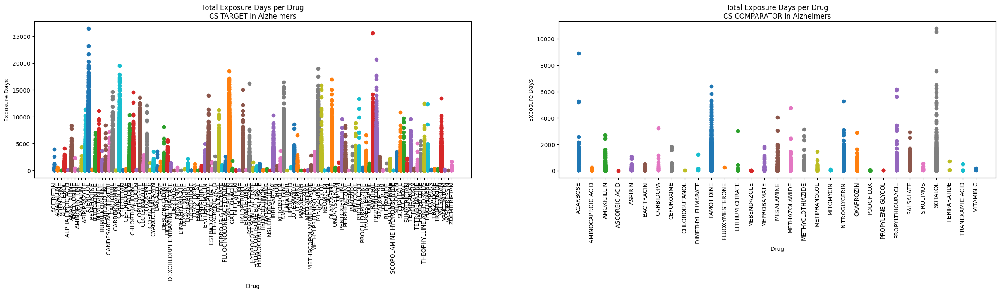

Number of brand names in target group 117
Number of brand names in comparator group 31
Number of unique patients in target group 315030
Number of patients in the comparator group 32774


In [0]:
# first count days supply by target cohort
targ_df_2 = targ_df_2.na.fill(1, subset=["t_DAYS_SUP"]) # use a dummy count of 1 when no days are provided
targ_df_2 = targ_df_2.withColumn("t_DAYS_SUP_INT", col("t_DAYS_SUP").cast("integer"))
drug_sum_df = targ_df_2.groupBy("t_PATID", "t_BRND_NM").agg(_sum("t_DAYS_SUP_INT").alias("t_total_days_supply")) # total days per patient
# drug_count_df = targ_df_2.groupBy("PATID", "BRND_NM").agg(count("*").alias("COUNT")) # total count per patient

targ_df = drug_sum_df.toPandas()
targ_data_series = targ_df.groupby("t_BRND_NM")["t_total_days_supply"].apply(list)
targ_sorted_drug_names = targ_data_series.keys()

# Create a boxplot per drug
fig_a, ax_a = plt.subplots(1, 2, figsize=(30, 6))
for (i,days_list) in enumerate(targ_data_series):
  x = [i+1] * len(days_list)
  ax_a[0].scatter(x,days_list)
ax_a[0].set_xlabel("Drug")
ax_a[0].set_ylabel("Exposure Days")
ax_a[0].set_title("Total Exposure Days per Drug\n"+DRUG_CLASS+" TARGET in Alzheimers")
ax_a[0].set_xticks(range(1,len(targ_sorted_drug_names)+1))
ax_a[0].set_xticklabels(targ_sorted_drug_names,rotation=90)

comp_df_2 = comp_df_2.na.fill(1, subset=["c_DAYS_SUP"]) # use a dummy count of 1 when no days are provided
comp_df_2 = comp_df_2.withColumn("c_DAYS_SUP_INT", col("c_DAYS_SUP").cast("integer"))
drug_sum_df_comp = comp_df_2.groupBy("c_PATID", "c_BRND_NM").agg(_sum("c_DAYS_SUP_INT").alias("c_total_days_supply"))

comp_df = drug_sum_df_comp.toPandas()
comp_data_series = comp_df.groupby("c_BRND_NM")["c_total_days_supply"].apply(list)
comp_sorted_drug_names = comp_data_series.keys()

for (i,days_list) in enumerate(comp_data_series):
  x = [i+1] * len(days_list)
  ax_a[1].scatter(x,days_list)
ax_a[1].set_xlabel("Drug")
ax_a[1].set_ylabel("Exposure Days")
ax_a[1].set_title("Total Exposure Days per Drug\n"+DRUG_CLASS+" COMPARATOR in Alzheimers")
ax_a[1].set_xticks(range(1,len(comp_sorted_drug_names)+1))
ax_a[1].set_xticklabels(comp_sorted_drug_names,rotation=90)

plt.subplots_adjust(bottom=0.25)
plt.show()

print('Number of brand names in target group', len(targ_sorted_drug_names))
print('Number of brand names in comparator group', len(comp_sorted_drug_names))

tunique_patient_count = targ_df_2.select(countDistinct("t_PATID").alias("unique_patient_count")).first()
count_t = tunique_patient_count["unique_patient_count"]
cunique_patient_count = comp_df_2.select(countDistinct("c_PATID").alias("unique_patient_count")).first()
count_c = cunique_patient_count["unique_patient_count"]

print('Number of unique patients in target group', count_t)
print('Number of patients in the comparator group', count_c)

In [0]:
rdf_others_temp = rdf_az.join(talias,rdf_az.BRND_NM == talias['t_BRND_NM'],'left').join(calias,rdf_az.BRND_NM == calias['c_BRND_NM'],'left')
rdf_others = rdf_others_temp.filter(col('t_BRND_NM').isNull() & col('c_BRND_NM').isNull()).select(['PATID','BRND_NM']).distinct()
rdf_others.show()

rdf_others.write.format("csv").option("header","true").mode("OverWrite").csv("/mnt/pathfx-als/202302_az_rdf_others_temp.csv")

+-----------+--------------------+
|      PATID|             BRND_NM|
+-----------+--------------------+
|33038035633|        INDOMETHACIN|
|33075271189|  CARBIDOPA/LEVODOPA|
|33063453575|  CARBIDOPA/LEVODOPA|
|33031464574|        INDOMETHACIN|
|33044117670|     FLUOROMETHOLONE|
|33221319659|  LORAZEPAM INTENSOL|
|33168909979|TRESIBA FLEXTOUCH...|
|33168931252|     ONETOUCH ULTRA2|
|33168940413|  LORAZEPAM INTENSOL|
|33031710083|        INDOMETHACIN|
|33038587800|  FLUVIRIN 2012-2013|
|33037548902|     NAPROXEN SODIUM|
|33168927076|     FLUOROMETHOLONE|
|33168938039|     NAPROXEN SODIUM|
|33168974861|     ONETOUCH ULTRA2|
|33031722486|  FLUVIRIN 2012-2013|
|33037683240|        INDOMETHACIN|
|33222125419|            INGREZZA|
|33043533172|  LORAZEPAM INTENSOL|
|33037636018|        INDOMETHACIN|
+-----------+--------------------+
only showing top 20 rows



In [0]:
rdf_others_temp = spark.read.option("header","true").csv("/mnt/pathfx-als/202302_az_rdf_others_temp.csv")
rdf_others_count = rdf_others_temp.groupBy('BRND_NM').agg(count("*").alias("COUNT")).filter(col("COUNT") > 5000) # yeilds 539 rows
display(rdf_others_count)

BRND_NM,COUNT
METOPROLOL TARTRATE,161329
HYDROCODONE-ACETAMINOPHEN,254271
AMLODIPINE BESYLATE,219152
NYSTATIN,96149
KLOR-CON M10,22070
NEOMYCIN-POLYMYXIN-HC,17187
FLUZONE HIGH-DOSE 2015-2016,33012
NITROSTAT,33220
OFLOXACIN,36045
SULFAMETHOXAZOLE-TRIMETHOPRIM,204264


In [0]:
# join with DOD, format, calculate "min date" as first exposure to either drug class
col_list = ['PATID','dod_YMDOD','DAYS_SUP','FILL_DT']
targ_df_wDOD = targ_df_2.select([col(c).alias(c.replace('t_', '')) for c in targ_df_2.columns])
comp_df_wDOD = comp_df_2.select([col(c).alias(c.replace('c_', '')) for c in targ_df_2.columns])

doddf = spark.read.format("delta").load('dbfs:/mnt/optumclin/202302/ontology/base/dod/Death/')
doddf_az = doddf.join(mdf_az, doddf['PATID']== mdf_az['azp_PATID'], 'inner')
doddf_az = doddf_az.select([col(c).alias("dod_" + c) for c in doddf_az.columns])
target_with_outcome = doddf_az.join(targ_df_wDOD, doddf_az["dod_PATID"] == targ_df_wDOD["PATID"], "right").select(col_list) 
comparator_with_outcome = doddf_az.join(comp_df_wDOD, doddf_az["dod_PATID"] == comp_df_wDOD["PATID"], "right").select(col_list)

# Define a window specification partitioned by patient ID and ordered by date
from pyspark.sql.functions import col, min
from pyspark.sql.window import Window
from pyspark.sql.functions import concat_ws, col, substring, lit
window_spec = Window.partitionBy("PATID").orderBy("FILL_DT")

# Add a column with the minimum date per patient, filter where fill date matches earliest date, modify dod column to be the first of the month
target_add_earliest_rx = target_with_outcome.withColumn("min_date", min(col("FILL_DT")).over(window_spec))
target_earliest_rx_only = target_add_earliest_rx.filter(col("FILL_DT") == col("min_date"))
target_earliest_rx_only = target_earliest_rx_only.withColumn("dod_year_month", concat_ws("-", substring(col("dod_YMDOD"), 1, 4), substring(col("dod_YMDOD"), 5, 2), lit("01")))

comp_add_earliest_rx = comparator_with_outcome.withColumn("min_date", min(col("FILL_DT")).over(window_spec))
comp_earliest_rx_only = comp_add_earliest_rx.filter(col("FILL_DT") == col("min_date"))
comp_earliest_rx_only = comp_earliest_rx_only.withColumn("dod_year_month", concat_ws("-", substring(col("dod_YMDOD"), 1, 4), substring(col("dod_YMDOD"), 5, 2), lit("01")))

from pyspark.sql.functions import datediff
target_earliest_rx_only = target_earliest_rx_only.withColumn("date_diff", datediff(target_earliest_rx_only.dod_year_month, target_earliest_rx_only.FILL_DT))
comp_earliest_rx_only = comp_earliest_rx_only.withColumn("date_diff", datediff(comp_earliest_rx_only.dod_year_month, comp_earliest_rx_only.FILL_DT))
display(comp_earliest_rx_only)

# add treatment effect and combine tables
target_earliest_rx_only = target_earliest_rx_only.withColumn("treatment", lit(1))
comp_earliest_rx_only = comp_earliest_rx_only.withColumn("treatment", lit(0))
pts_w_tr_ocs = target_earliest_rx_only.union(comp_earliest_rx_only) # patients with treatments and outcomes


PATID,dod_YMDOD,DAYS_SUP,FILL_DT,min_date,dod_year_month,date_diff
33003514094,200802,3,2005-08-09,2005-08-09,2008-02-01,906
33004081014,201110,30,2011-02-02,2011-02-02,2011-10-01,241
33004106455,201806,14,2011-11-01,2011-11-01,2018-06-01,2404
33004132521,200504,30,2002-04-18,2002-04-18,2005-04-01,1079
33004235752,null,30,2008-09-16,2008-09-16,01,null
33004355422,null,30,2017-05-25,2017-05-25,01,null
33005281644,201604,5,2012-04-27,2012-04-27,2016-04-01,1435
33005518693,200605,30,2005-01-03,2005-01-03,2006-05-01,483
33005762988,201007,10,2002-03-19,2002-03-19,2010-07-01,3026
33006407135,200511,7,2001-10-02,2001-10-02,2005-11-01,1491


In [0]:
# now take the union of covariates and expand for logisitic regression
mdf_nonAZ_count_alias = mdf_nonAZ_count.select([col(c).alias("mdfc_" + c) for c in mdf_nonAZ_count.columns])
mdf_other_az_top = mdf_other_az.join(mdf_nonAZ_count_alias,mdf_other_az.DIAG == mdf_nonAZ_count_alias.mdfc_DIAG,'left').filter(~col('mdfc_COUNT').isNull())
mdf_other_az_top = mdf_other_az_top.select(['PATID','DIAG']).withColumnRenamed("DIAG","covar").distinct()

rdf_others_count_alias = rdf_others_count.select([col(c).alias("rdfo_" + c) for c in rdf_others_count.columns])
rdf_others_temp_top = rdf_others_temp.join(rdf_others_count_alias,rdf_others_temp.BRND_NM == rdf_others_count_alias.rdfo_BRND_NM,'left').filter(~col('rdfo_COUNT').isNull())
rdf_others_temp_top = rdf_others_temp_top.select(['PATID','BRND_NM']).withColumnRenamed("BRND_NM","covar").distinct()

all_covar = mdf_other_az_top.union(rdf_others_temp_top)

# Pivot the column with covariate IDs
pivoted_df = all_covar.groupBy("PATID").pivot("covar").agg(lit(1)).fillna(0)

# load demographic information, create alias and select relevant tables
memdf = spark.read.format("delta").load('dbfs:/mnt/optumclin/202302/ontology/base/dod/Member Enrollment/')
mem_alias = memdf.select([col(c).alias("mem_" + c) for c in memdf.columns])
mem_col = ['mem_GDR_CD','mem_RACE','mem_YRDOB']
diag_rx_cov_cols = pivoted_df.columns
cov_cols = diag_rx_cov_cols + mem_col
cov_cols.remove("DEXTROSE 5%-0.45% NACL")
# print(cov_cols)
covdf = pivoted_df.join(mem_alias,(pivoted_df.PATID == mem_alias.mem_PATID),'left').select(cov_cols)

# put the treatments values back
pts_w_tr_ocs_alias = pts_w_tr_ocs.select([col(c).alias("tr_" + c) for c in pts_w_tr_ocs.columns])
logr_col = covdf.columns + ["tr_treatment"]
covdf = covdf.join(pts_w_tr_ocs_alias,covdf.PATID == pts_w_tr_ocs_alias.tr_PATID).select(logr_col)
# display(covdf) # will have duplicates because of patients having multiple entries for the same diagnosis code (separate visits), or same RX (because refills)

covdf_distinct = covdf.distinct()
display(covdf_distinct)
# save the covariates data frame
covdf_distinct.write.format("csv").option("header","true").mode("OverWrite").csv("/mnt/pathfx-als/202302_"+DRUG_CLASS+"_az_covdf.csv")

PATID,0389,1101,2113,2382,2449,25000,25002,25060,2662,2689,2720,2722,2724,2761,27651,2768,2809,2851,2859,28860,2900,2930,29410,29411,29420,2948,2989,30000,311,3319,3569,36251,36511,36616,36653,3669,3674,37515,37921,3804,4010,4011,4019,40390,412,41400,41401,4149,4240,4241,4242,42731,42781,42789,4279,4280,4293,43310,43491,4359,436,4371,4400,44020,4439,4550,4589,4619,4659,4660,4779,486,490,49390,496,5119,514,5180,51881,51889,53081,53550,5533,5589,56210,56400,5789,5849,5853,5859,5939,5990,59970,60000,6829,6929,7020,70211,70219,7030,7038,71509,71516,71590,71596,71690,71941,71945,71946,71947,7197,7213,72252,7231,72402,7242,7244,7245,72887,7291,7295,72981,73300,73390,7354,78002,78009,7802,78039,7804,78052,78060,78079,78093,78097,78099,7812,7813,7820,7821,7823,78321,7840,7850,7851,78605,78609,7862,78650,78659,78701,78702,78703,78720,78791,7881,78820,78830,78841,78900,78907,78909,79029,7906,7931,79319,79431,7962,79902,7993,920,95901,A419,ABILIFY,ACCU-CHEK,ACCU-CHEK AVIVA PLUS,ACCU-CHEK FASTCLIX,ACCU-CHEK GUIDE TEST STRIP,ACCU-CHEK SMARTVIEW,ACCU-CHEK SOFTCLIX,ACETAMINOPHEN W/CODEINE,ACETAMINOPHEN-CODEINE,ACIPHEX,ACTONEL,ACTOS,ACULAR LS,ACYCLOVIR,ADACEL TDAP,ADVAIR DISKUS,AGGRENOX,ALBUTEROL SULFATE,ALBUTEROL SULFATE HFA,ALCOHOL PREP PADS,ALENDRONATE SODIUM,ALLEGRA,ALLOPURINOL,ALPHAGAN P,ALPRAZOLAM,ALTACE,AMBIEN,AMBIEN CR,AMIODARONE HCL,AMITIZA,AMITRIPTYLINE HCL,AMLODIPINE BESYLATE,AMLODIPINE BESYLATE-BENAZEPRIL,AMMONIUM LACTATE,AMOX TR-POTASSIUM CLAVULANATE,AMOXICILLIN-CLAVULANATE POTASS,AMPICILLIN TRIHYDRATE,ANASTROZOLE,ARICEPT,ASTELIN,ATORVASTATIN CALCIUM,ATROPINE SULFATE,AUTOSHIELD DUO PEN NEEDLE,AVANDIA,AVELOX,AVODART,AZELASTINE HCL,AZITHROMYCIN,AZOPT,B351,B9620,BACLOFEN,BACTROBAN,BD ULTRA-FINE PEN NEEDLE,BENAZEPRIL HCL,BENICAR,BENICAR HCT,BENZONATATE,BENZTROPINE MESYLATE,BESIVANCE,BETAMETHASONE DIPROPIONATE,BETAMETHASONE VALERATE,BONIVA,BOOSTRIX TDAP,BREO ELLIPTA,BRIMONIDINE TARTRATE,BUPROPION HCL,BUPROPION HCL SR,BUPROPION XL,BUSPIRONE HCL,BYSTOLIC,CALCITONIN-SALMON,CALCITRIOL,CARAFATE,CARBAMAZEPINE,CARBIDOPA-LEVODOPA,CARBIDOPA-LEVODOPA ER,CARBIDOPA/LEVODOPA,CARISOPRODOL,CARTIA XT,CEFADROXIL,CEFDINIR,CEFPODOXIME PROXETIL,CELEBREX,CELECOXIB,CHERATUSSIN AC,CHLORHEXIDINE GLUCONATE,CHOLESTYRAMINE,CICLOPIROX,CILOSTAZOL,CIPRO,CIPRODEX,CIPROFLOXACIN HCL,CITALOPRAM HBR,CLARITHROMYCIN,CLINDAMYCIN HCL,CLINDAMYCIN PHOSPHATE,CLOBETASOL PROPIONATE,CLONAZEPAM,CLONIDINE,CLONIDINE HCL,CLOPIDOGREL BISULFATE,CLOTRIMAZOLE-BETAMETHASONE,CLOTRIMAZOLE/BETAMETHASONE,COLCHICINE,COLCRYS,COMBIGAN,COMBIVENT,COMBIVENT RESPIMAT,COMPRO,CONTOUR,COREG,COUMADIN,COZAAR,CRESTOR,CYANOCOBALAMIN INJECTION,CYCLOBENZAPRINE HCL,CYMBALTA,CYPROHEPTADINE HCL,D485,D509,D62,D649,D696,D72829,DEPAKOTE,DESONIDE,DESOXIMETASONE,DETROL LA,DEXILANT,DEXTROSE WITH SODIUM CHLORIDE,DIAZEPAM,DICLOFENAC SODIUM,DICYCLOMINE HCL,DIGITEK,DIGOX,DIGOXIN,DILT-XR,DILTIAZEM 24HR CD,DILTIAZEM 24HR ER,DILTIAZEM 24HR ER (CD),DILTIAZEM ER,DILTIAZEM HCL,DIOVAN,DIOVAN HCT,DIPHENOXYLATE-ATROPINE,DIVALPROEX SODIUM,DIVALPROEX SODIUM ER,DONEPEZIL HCL,DORZOLAMIDE HCL,DORZOLAMIDE-TIMOLOL,DOXAZOSIN MESYLATE,DOXEPIN HCL,DOXYCYCLINE HYCLATE,DOXYCYCLINE MONOHYDRATE,DULOXETINE HCL,DUONEB,DUREZOL,E039,E1122,E1140,E1142,E1151,E1165,E119,E46,E538,E559,E669,E780,E7800,E782,E785,E860,E870,E871,E872,E875,E876,E8859,E8889,ECONAZOLE NITRATE,EFFEXOR XR,ELIQUIS,ENABLEX,ENALAPRIL MALEATE,ENDOCET,ENOXAPARIN SODIUM,ENULOSE,ESCITALOPRAM OXALATE,ESOMEPRAZOLE MAGNESIUM,ESTRACE,ETODOLAC,EVISTA,EXELON,EZETIMIBE,F0150,F0280,F0281,F0390,F0391,F05,F329,F331,F339,F411,F419,FAMCICLOVIR,FELODIPINE ER,FENOFIBRATE,FEXOFENADINE HCL,FINASTERIDE,FLOMAX,FLONASE,FLOVENT HFA,FLUAD 2017-2018,FLUAD 2018-2019,FLUAD 2019-2020,FLUAD QUAD 2020-2021,FLUAD QUAD 2021-2022,FLUAD QUAD 2022-2023,FLUCONAZOLE,FLUDROCORTISONE ACETATE,FLUOCINONIDE,FLUOROMETHOLONE,FLUOROURACIL,FLUOXETINE HCL,FLUTICASONE PROPIONATE,FLUVIRIN,FLUVIRIN 2011-2012,FLUVIRIN 2013-2014,FLUVIRIN 2014-2015,FLUVIRIN 2015-2016,FLUZONE HIGH-DOSE 2013-2014,FLUZONE HIGH-DOSE 2014-2015,FLUZONE H

In [0]:
covdf.groupBy('mem_RACE').count().show()
covdf.groupBy('mem_GDR_CD').count().show()

+--------+-------+
|mem_RACE|  count|
+--------+-------+
|    NULL| 138907|
|       B| 315787|
|       A|  69815|
|       W|1875111|
|       H| 326969|
+--------+-------+

+----------+-------+
|mem_GDR_CD|  count|
+----------+-------+
|         F|1805636|
|         M| 920741|
|         U|    202|
|      NULL|     10|
+----------+-------+



In [0]:
# implement logistic regression, look at covariate balance, save propensity scores
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import mean_squared_error, r2_score, accuracy_score
import matplotlib.pyplot as plt
import statsmodels.api as sm
import numpy as np

covdf = spark.read.option("header","true").csv("/mnt/pathfx-als/202302_"+DRUG_CLASS+"_az_covdf.csv")
df = covdf.toPandas()
cov_cols = [c for c in df.columns if c != 'tr_treatment' and c != 'PATID']

sex_dic = {'M':1,'F':0}
race_dic = {'B':1,'A':2,'W':3,'H':4}

X = df[cov_cols].fillna(0)
X['mem_RACE'] = X['mem_RACE'].map(race_dic)
X['mem_RACE'] = X['mem_RACE'].fillna(0) # fill those not recorded
X['mem_GDR_CD'] = X['mem_GDR_CD'].map(sex_dic)
X['mem_GDR_CD'] = X['mem_GDR_CD'].fillna(2) # not sure what to fill when sex not recorded
y = df['tr_treatment']

psmodel = LogisticRegression(random_state=5)
psmodel.fit(X, y)
predicted_probs = psmodel.predict_proba(X)
predicted_classes = psmodel.predict(X)
prob_treat = [x[0] for x in predicted_probs]
df['propensity_score'] = prob_treat

# assessment, eventually convert and save covariates
print('Mean squared error: %.2f'% mean_squared_error(y, predicted_classes))
print('Coefficient of determination: %.2f'% r2_score(y, predicted_classes))

# TO-DO Map Coefficients and get the top values
reg_coef = list(zip(cov_cols, psmodel.coef_[0]))
sort_rc = sorted(reg_coef,key = lambda x:x[1],reverse=True)

# merge with outcomes data, save for survival analysis
pts_w_tr_ocs = pts_w_tr_ocs.withColumn("event_occurred", when(col("date_diff").isNull(), 0).otherwise(1))
pdf = pts_w_tr_ocs.toPandas()
pdf['date_diff'] = pdf['date_diff'].astype(float).fillna(9999)
pdf_short = pdf[['PATID','date_diff']]

df['PATID']=df['PATID'].astype(str)
pdf_short['PATID']=pdf_short['PATID'].astype(str)
fulldf = pd.merge(df, pdf_short, on='PATID', how="left")
fulldf = fulldf[['PATID','tr_treatment','date_diff','propensity_score']]
fulldf['censored'] = np.where(fulldf['date_diff']== 9999, 1, 0)
# display(fulldf)
fulldf_spark = spark.createDataFrame(fulldf)
fulldf_spark.write.format("csv").option("header","true").mode("OverWrite").csv("/mnt/pathfx-als/202302_"+DRUG_CLASS+"_AZ_survival_df.csv")

/databricks/python/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Mean squared error: 0.09
Coefficient of determination: -0.10


/root/.ipykernel/4713/command-3813094128287580-1372314901:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pdf_short['PATID']=pdf_short['PATID'].astype(str)


In [0]:
lud = spark.read.format("delta").load('/mnt/optumclin/202302/ontology/base/dod/Lookup Diagnosis/')
memdf_als = spark.read.option("header","true").csv("/mnt/pathfx-als/202302_member_info_als.csv")
reg_coef = list(zip(cov_cols, psmodel.coef_[0]))
rc_df = pd.DataFrame(reg_coef, columns =['Code', 'Coefficient'])
rcdf_spark = spark.createDataFrame(rc_df)
rcdf_with_desc = rcdf_spark.join(lud, rcdf_spark.Code == lud.DIAG_CD,'left').select(['Code', 'Coefficient','DIAG_DESC']).distinct()
display(rcdf_with_desc)

Code,Coefficient,DIAG_DESC
2113,-0.017308300359349348,BENIGN NEOPLASM OF COLON
2113,-0.017308300359349348,UNKNOWN DIAGNOSIS
25060,0.05288375386537751,DB W/NEURO TYPE II/UNS NOT UNCNTRL
25060,0.05288375386537751,UNKNOWN DIAGNOSIS
2720,-0.05951767481215109,UNKNOWN DIAGNOSIS
2720,-0.05951767481215109,PURE HYPERCHOLESTEROLEMIA
2930,0.02274465203307578,DELIRIUM DUE CONDS CLASSIFIED ELSW
2930,0.02274465203307578,UNKNOWN DIAGNOSIS
2948,0.010231187573217823,UNKNOWN DIAGNOSIS
2948,0.010231187573217823,OTH PERSIST MENTL D/O COND CLSS ELS


Text(0.5, 1.0, 'AZ, CS\ntarget')

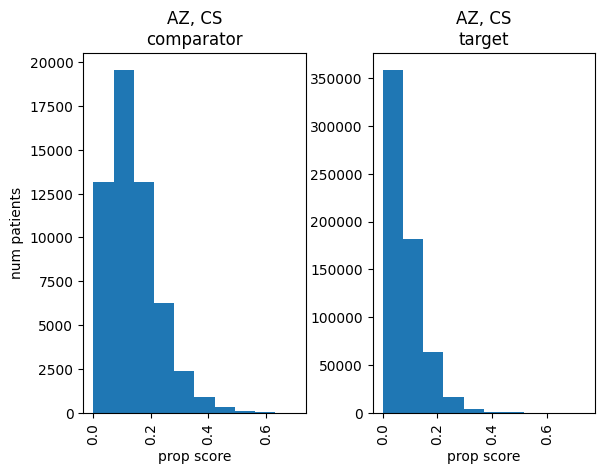

In [0]:
fig,ax = plt.subplots(1,2)
fulldf['propensity_score'].hist(by=fulldf['tr_treatment'],ax=ax)
ax[0].set_xlabel("prop score")
ax[0].set_ylabel("num patients")
ax[1].set_xlabel("prop score")
ax[0].set_title("AZ, " + DRUG_CLASS + "\ncomparator")
ax[1].set_title("AZ, " + DRUG_CLASS + "\ntarget")

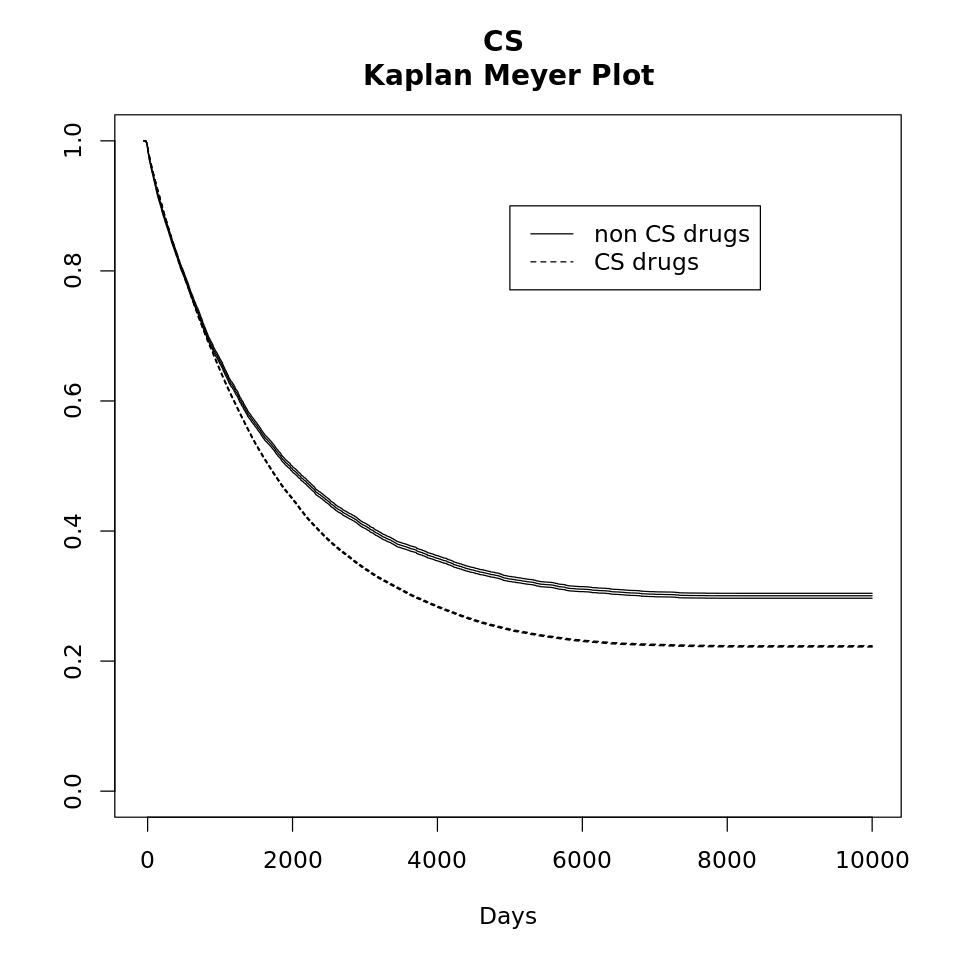


Attaching package: ‘dplyr’

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Attaching package: ‘SparkR’

The following object is masked _by_ ‘.GlobalEnv’:

    setLocalProperty

The following objects are masked from ‘package:dplyr’:

    arrange, between, coalesce, collect, contains, count, cume_dist,
    dense_rank, desc, distinct, explain, expr, filter, first, group_by,
    intersect, lag, last, lead, mutate, n, n_distinct, ntile,
    percent_rank, rename, row_number, sample_frac, select, slice, sql,
    summarize, union, where

The following object is masked from ‘package:ggplot2’:

    expr

The following objects are masked from ‘package:stats’:

    cov, filter, lag, na.omit, predict, sd, var, window

The following objects are masked from ‘package:base’:

    as.data.frame, colnames, colnames<-, drop, endsWith, intersect,
    rank, rbind, sample, startsWith, s

In [0]:
%r # re-read the PySpark table into R as a dataframe
library(survival)
library(ggplot2)
library(dplyr)
library(SparkR)

DRUG_CLASS <- "CS"
sparkR.session()
fullfilepath <- paste("/mnt/pathfx-als/202302_",DRUG_CLASS,"_AZ_survival_df.csv",sep="") # "/mnt/pathfx-als/202302_"+DRUG_CLASS+"_AZ_survival_df.csv"
sdata = read.df(fullfilepath,"csv", sep = ",", inferSchema = TRUE, header = TRUE)
sdf = as.data.frame(sdata)

# https://rviews.rstudio.com/2017/09/25/survival-analysis-with-r/
km_fit <- survfit(Surv(date_diff, !censored) ~ tr_treatment, data=sdf)
summary(km_fit, times = c(1,30,60,90*(1:10)))
plot(km_fit, xlab="Days", main = paste(DRUG_CLASS,'\nKaplan Meyer Plot'), conf.int = TRUE, lty=1:2)
legend(5000, .9, c(paste("non", DRUG_CLASS, "drugs"), paste(DRUG_CLASS, "drugs")), lty = 1:2)

# implement weighting
weights <- ifelse(sdf$tr_treatment==1, 1/sdf$propensity_score , 1/(1-sdf$propensity_score))
HR5 <- coxph(Surv(date_diff, !censored)~as.factor(tr_treatment), weights = weights, data = sdf) 
summary(HR5)

In [0]:
DRUG_CLASS = 'CS'
tdrug_str = cs_syns # target
tdrug_list = [d.upper() for d in tdrug_str.split(',')]
cdrug_str = non_cs_syns # comparator
cdrug_list = [d.upper() for d in cdrug_str.split(',')]

targ_temp_rdf = rdf_az.filter(rdf_az.BRND_NM.isin(tdrug_list))
comp_temp_rdf = rdf_az.filter(rdf_az.BRND_NM.isin(cdrug_list))

tt_patids = set([r.PATID for r in targ_temp_rdf.select(['PATID']).collect()])
ct_patids = set([r.PATID for r in comp_temp_rdf.select(['PATID']).collect()])
t_uni_pat = tt_patids.difference(ct_patids)
c_uni_pat = ct_patids.difference(tt_patids)

targ_rdf = targ_temp_rdf.filter(targ_temp_rdf.PATID.isin(t_uni_pat))
comp_rdf = comp_temp_rdf.filter(comp_temp_rdf.PATID.isin(c_uni_pat))